In [1]:
import INN

import torch
import torch.nn as nn
import torch.utils.data as data
import torch.optim as optim
%matplotlib inline
import numpy as np
import scipy.stats as stats

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import random
from pylab import rcParams
%matplotlib inline

import torch
from torch import nn
from torch import distributions
from torch.nn.parameter import Parameter
from importlib import reload
import EI_calculation
# reload(models_new)
# from models_new import Renorm_Dynamic
reload(EI_calculation)
from EI_calculation import approx_ei


use_cuda = torch.cuda.is_available()
#use_cuda = 0
device = torch.device('cuda:0') if use_cuda else torch.device('cpu')
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import KernelDensity
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV

def transform(ss, sps, size):
    data = torch.cat((ss,sps[-size:,:]),0)
    mean_values = torch.mean(data, dim = 0)  # 计算输入数据的均值
    std_values = torch.std(data, dim = 0)  # 计算输入数据的标准差
    ss = (ss - mean_values) / std_values
    sps = (sps - mean_values) / std_values
    return ss,sps

def kde_density(X):
    is_cuda = X.is_cuda  #True is stored in GPU.
    ldev = X.device  #Running the allocation of memory within a certain space.
    dim = X.size()[1] #The number of columns in obtaining the data is the dimension.
    kde = KernelDensity(kernel='gaussian', bandwidth=0.02, atol=0.0001).fit(X.cpu().data.numpy())
    log_density = kde.score_samples(X.cpu().data.numpy())
    return log_density, kde

def to_weights(log_w, temperature): 
    #Normalize log_w using softmax and obtain the weights.
    logsoft = nn.LogSoftmax(dim = 0)
    weights = torch.exp(logsoft(log_w/temperature))
    return weights

def test_model_causal_multi_sis(spring_data,  MAE_raw, MSE_raw,
                                net1, sigma, scale,
                                num_samples, bigL=100):
    #EI calculation function
    sigmas_matrix = torch.zeros([2,2],device=device)
    s,sp,l,lp=spring_data
    samples = s.size()[0]
    s, sp = transform(s, sp, num_samples)
    encode,_,_,_ = net1.encode(sp)
    predicts1, latentp1, latent1, _, _, _ = net1(s)
    data = torch.cat((encode,latent1[:num_samples,:]),0)
    std_values = torch.std(data, dim = 0) 
    L_list = 5 * std_values
    log_density, k_model_n = kde_density(latent1)
    log_rho = - torch.sum(torch.log(2.0 * L_list)).cpu().detach()  #Uniform distribution probability distribution
    logp = log_rho - log_density  #The difference between two probability distributions.
    weights = to_weights(logp, temperature) * samples
    if use_cuda:
        weights = weights.cuda(device=device)
    weights = weights.unsqueeze(1)
    me = 'mse'
    mae1 = MSE_raw(latentp1, encode) * torch.cat((weights,weights),1)
    if (me == 'mae'):
        mae1 = MAE_raw(latentp1, encode) * torch.cat((weights,weights),1)
    sigmas = mae1.mean(axis=0)
    data_scale=torch.std(encode)
    # sigmas=sigmas/data_scale
    sigmas_matrix = torch.diag(sigmas)
    # ei = approx_ei(scale, scale, sigmas_matrix.data, lambda x:(net1.dynamics(x.unsqueeze(0))+x.unsqueeze(0)), 
    #                    num_samples = num_samples, L = L_list, easy=True, device=device) 
    ei = approx_ei(scale, scale, sigmas_matrix.data, lambda x:(net1.dynamics(x.unsqueeze(0))[0]+x.unsqueeze(0)), 
                       num_samples = num_samples, L = L_list, easy=True, device=device) 

    return ei, sigmas,weights

from datetime import datetime
t0 = datetime.now()
def cpt(s):
    #Timing function
    global t0
    t = datetime.now()
    print(f'check point{s:->10}-> {t.time()}; lasting {t - t0} seconds')
    t0 = t
device

/home/yangmingzhe1/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps,
/home/yangmingzhe1/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:597: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).ep

device(type='cuda', index=0)

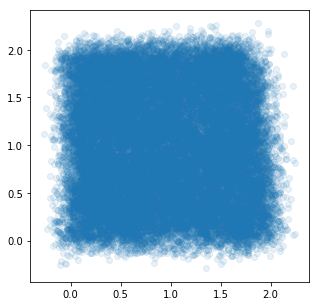

In [4]:
train_size = 3000
test_size = 100
steps = 10
batch_size = steps * 100

sigma = 0.03
rou = -0.5

def SIR_step(s,i,lam,miu,noise2=0,dt=1):        
    if noise2==0:
        s=s-dt* lam * s * i
        i=i+dt*(lam * s * i - miu * i)
    else:
        prior = distributions.MultivariateNormal(torch.zeros(2,device=device).float(), torch.tensor([[1,0],[0,1]],device=device).float()*noise2*noise2)
        rand=prior.sample([1])

        s=s-dt* lam * s * i+rand[0,0]
        i=i+dt*(lam * s * i - miu * i)+rand[0,1]
    return s,i

def LV_step(U, V, alpha=0.3, gamma=1, beta=0.2, e=2, noise2=0, dt=1):        
    if noise2==0:
        U=U+dt* (alpha* U -gamma*U*V)
        V=V+dt*(-beta* V  + e*gamma*U * V)
    else:
        prior = distributions.MultivariateNormal(torch.zeros(2,device=device).float(), torch.tensor([[1,0],[0,1]],device=device).float()*noise2*noise2)
        rand=prior.sample([1])

        U=U+dt* (alpha* U -gamma*U*V)+rand[0,0]
        V=V+dt*(-beta* V  + e*gamma*U * V)+rand[0,1]
    return U,V
    
def perturb(s, sigma,rou):
    prior = distributions.MultivariateNormal(torch.zeros(2,device=device), torch.tensor([[1,rou],[rou,1]],device=device)*sigma*sigma)
    rand1=prior.sample([s.size()[0]])
    rand2=prior.sample([s.size()[0]])
    s1 = s[:,0].unsqueeze(1) + rand1
    s2 = s[:,1].unsqueeze(1) + rand2
    s1_= torch.cat((s1[:,[0]], s2[:,[0]]), 1)
    s2_= torch.cat((s1[:,[1]], s2[:,[1]]), 1)
    sr = torch.cat((s1_, s2_), 1)
    return sr

def generate_lv_randn(size, steps, lb_u, ub_u, lb_v, ub_v, 
                        alpha=0.3, gamma=1, beta=0.2, e=2, sigma=1,
                        rou=-1, dt=1, noise2=0, interval=1, part=False):
    #Be able to build a sample set with missing values.
    u = torch.randn(size,device=device) * (ub_u - lb_u) + lb_u
    v = torch.randn(size,device=device) * (ub_v - lb_v) + lb_v
    u = u.unsqueeze(1)
    v = v.unsqueeze(1)
    history = torch.cat((u,v), 1)
    observ_hist = perturb(history, sigma, rou)
    for k in range(1, steps+1):
        u, v = LV_step(u, v, alpha, gamma, beta, e, noise2=noise2, dt=dt)
        uv = torch.cat((u,v), 1)
        uv_p = perturb(uv, sigma, rou)
        if k%interval==0:
            history = torch.cat((history, uv),0)
            observ_hist = torch.cat((observ_hist, uv_p),0)
    return observ_hist[:-size,:], observ_hist[size:,:], history[:-size,:], history[size:,:]

def generate_lv_rand(size, steps, lb_u, ub_u, lb_v, ub_v,
                        alpha=0.3, gamma=1, beta=0.2, e=2, sigma=1, rou=-1, dt=1, noise2=0, interval=1):
    #Be able to build a sample set with missing values.
    # u = torch.cat(( (torch.rand(int(size/3), device=device)*(ub_u - lb_u)/5 + lb_u).unsqueeze(1),
    #                 (torch.rand(int(size/3), device=device)*(ub_u - lb_u)/5 + lb_u + (ub_u - lb_u)*2/5).unsqueeze(1),
    #                 (torch.rand(size-2*int(size/3), device=device)*(ub_u - lb_u)/5 + lb_u + (ub_u - lb_u)*4/5).unsqueeze(1)
    #                 ))
    # u = (torch.rand(size, device=device)*(ub_u - lb_u) + lb_u).unsqueeze(1)
    # v = (torch.rand(size, device=device)*(ub_v - lb_v) + lb_v).unsqueeze(1)
    
    # u1 = - (torch.rand(5, device=device)*(ub_u - lb_u)*1/3 - ub_u).unsqueeze(1)
    # v1 = (torch.rand(5, device=device)*(ub_v - lb_v) + lb_v).unsqueeze(1)
    # u = torch.cat((u,u1), 0)
    # v = torch.cat((v,v1), 0)

    u = torch.rand(size, device=device)*2
    v = torch.rand(size, device=device)*2
    u = u.unsqueeze(1)
    v = v.unsqueeze(1)
    history = torch.cat((u,v), 1)
    
    # observ_hist = perturb(history, sigma, rou)
    for k in range(1, steps+1):
        u, v = LV_step(u, v, alpha, gamma, beta, e, noise2=noise2, dt=dt)
        uv = torch.cat((u,v), 1)
        # uv_p = perturb(uv, sigma,rou)
        if k%interval==0:
            history = torch.cat((history, uv),0)
            # observ_hist = torch.cat((observ_hist, uv_p),0)
    noise = torch.randn([size*(steps+1),2],device=device)* 0.1
    obsery_hist = history + noise
    observ_hist = torch.cat((obsery_hist, noise), 1)
    #indices = torch.randperm(observ_hist.size(0), device=device)
    #shuffle_observ_hist = observ_hist[indices]
    #shuffle_history = history[indices]
    return observ_hist[:-size,:], observ_hist[size:,:], history[:-size,:], history[size:,:]

ss, sps, ls, lps = generate_lv_rand(size=train_size, steps=steps,
                                    lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                    sigma=sigma, rou=rou, alpha=0.3,
                                    gamma=1, beta=0.2, e=0.2, dt=0.01)
plt.figure(figsize=(5,5))
# plt.xlim(-1, 11)
# plt.ylim(-1, 11)
plt.scatter(sps.cpu().detach().numpy()[:,0], sps.cpu().detach().numpy()[:,1],alpha=0.1)

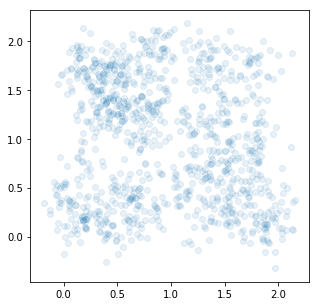

In [9]:
#构造分布外泛化的test数据，可以有不同的构造方法
def generate_lv_test(size, steps, lb_u, ub_u, lb_v, ub_v,
                        alpha=0.3, gamma=1, beta=0.2, e=0.2,
                        sigma=sigma, rou=rou, dt=0.01, noise2=0, interval=1):
#Be able to build a sample set with missing values.
    # u = torch.cat(( (torch.rand(int(size/2), device=device)*(ub_u - lb_u)/5 + lb_u + (ub_u - lb_u)*1/5).unsqueeze(1),
    #                 (torch.rand(size-int(size/2), device=device)*(ub_u - lb_u)/5 + lb_u + (ub_u - lb_u)*3/5).unsqueeze(1)
    #                 ))
    # u = (torch.rand(size, device=device)*(ub_u - lb_u)*1/3 + lb_u + (ub_u - lb_u)*2/3).unsqueeze(1)
    u = (torch.rand(size, device=device)*(ub_u - lb_u) + lb_u).unsqueeze(1)
    v = (torch.rand(size, device=device)*(ub_v - lb_v) + lb_v).unsqueeze(1)
    history = torch.cat((u,v), 1)
    observ_hist = perturb(history, sigma,rou)
    # for k in range(1, steps+1):
    #     u, v = LV_step(u, v, alpha, gamma, beta, e, noise2=noise2, dt=dt)
    #     uv = torch.cat((u,v),1)
    #     uv_p = perturb(uv, sigma,rou)
    #     if k%interval==0:
    #         history = torch.cat((history, uv),0)
    #         observ_hist = torch.cat((observ_hist, uv_p),0)
    for k in range(1, steps+1):
        u, v = LV_step(u, v, alpha, gamma, beta, e, noise2=noise2, dt=dt)
        uv = torch.cat((u,v), 1)
        # uv_p = perturb(uv, sigma,rou)
        if k%interval==0:
            history = torch.cat((history, uv),0)
            # observ_hist = torch.cat((observ_hist, uv_p),0)
    noise = torch.randn([size*(steps+1),2],device=device)* 0.1
    obsery_hist = history + noise
    observ_hist = torch.cat((obsery_hist, noise), 1)
    return observ_hist[:-size,:], observ_hist[size:,:], history[:-size,:], history[size:,:]


ss, sps, ls, lps = generate_lv_test(size=test_size, steps=steps, 
                                    lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                    sigma=sigma, rou=rou, alpha=0.3,
                                    gamma=1, beta=0.2, e=0.2, dt=0.01)
plt.figure(figsize=(5,5))
# plt.xlim(-1, 11)
# plt.ylim(-1, 11)
plt.scatter(ss.cpu().detach().numpy()[:,0],ss.cpu().detach().numpy()[:,1],alpha=0.1)

In [5]:
class GNIS(nn.Module):
    def __init__(self, sz, scale, hidden_units, device, inn_hidden = 4, length = 2, inn = 'NICE', interval = 20):
        super(GNIS, self).__init__()
        
        self.device = device
        net = lambda: INN.Nonlinear(sz, inn, k = inn_hidden)
        jac_lin = lambda: INN.JacobianLinear(sz, sz)#, k = inn_hidden)
        self.nets = [net() for _ in range(interval*(length-1))]
        self.jacs = [jac_lin() for _ in range(interval)]
        self.encoder = INN.Sequential(*[self.jacs[i//length] if i % length == (length-1)
                                        else self.nets[i//length*(length-1) + i%length]
                                        for i in range(interval*length)])
        self.projector = INN.ResizeFeatures(sz, scale)

        # self.dynamics = nn.Sequential(nn.Linear(scale, hidden_units), nn.LeakyReLU(), 
        #                             nn.Linear(hidden_units, hidden_units), nn.LeakyReLU(), 
        #                             nn.Linear(hidden_units, scale))
        
        nice_dyn = lambda: INN.Nonlinear(scale, inn, k = inn_hidden)
        self.dyn_nice = [nice_dyn() for _ in range(interval*(length-1))]
        jac_dyn = lambda: INN.JacobianLinear(scale, scale)#, k = inn_hidden)
        self.dyn_jac = [jac_dyn() for _ in range(interval)]
        self.dynamics = INN.Sequential(*[self.dyn_jac[i//length] if i % length == (length-1)
                                        else self.dyn_nice[i//length*(length-1) + i%length]
                                        for i in range(interval*length)])

        # nice_dyn = lambda: INN.Nonlinear(scale, inn, k = inn_hidden)
        # self.dyn_nice = [nice_dyn() for _ in range(interval)]
        # self.dynamics = INN.Sequential(*self.dyn_nice)

        
    def encode(self, x):
        z, logp, logdet = self.encoder(x)
        y, _, _ = self.projector(z)
        return y, logp, logdet, z
    
    def decode(self, y):
        x = self.projector.inverse(y)
        x = self.encoder.inverse(x)
        return x
    
    def forward(self, x):
        if len(x.size())<=1:
            x = x.unsqueeze(0)
        y, logp, logdet, z = self.encode(x)
        # y_next = self.dynamics(y)[0] + y
        y_next = self.dynamics(y)[0]
#         y_next = (y_next - torch.mean(y_next)) / torch.std(y_next)
        x_next = self.decode(y_next)
        return x_next, y_next, y, logp, logdet, z

#     def back_ward(self, x_next):
#         if len(x_next.size())<=1:
#             x_next = x_next.unsqueeze(0)
#         y_next, logp, logdet, z_next = self.encode(x_next)
#         # y = self.dynamics.inverse(y_next)[0] - y_next
#         y = self.dynamics.inverse(y_next)
# #         y_next = (y_next - torch.mean(y_next)) / torch.std(y_next)
#         x = self.decode(y)
#         return x
    
    def back_ward(self, x_next):
        if len(x_next.size())<=1:
            x_next = x_next.unsqueeze(0)
        y_next, logp, logdet, z_next = self.encode(x_next)
        # y = self.dynamics.inverse(y_next)[0] - y_next
        y = self.dynamics.inverse(y_next)
#         y_next = (y_next - torch.mean(y_next)) / torch.std(y_next)
        return y
    
def norm_test(data):
    stat1, p_value1 = stats.shapiro(data[:500, 0])
    stat2, p_value2 = stats.shapiro(data[:500, 1])
    # 打印结果
    print('Statistics = {:.3f}, p-value = {:.3f}'.format(stat1, p_value1))
    print('Statistics = {:.3f}, p-value = {:.3f}'.format(stat2, p_value2))
    # 判断是否可以认为数据服从正态分布
    alpha = 0.05
    if p_value1 > alpha and p_value2 > alpha:
        print('数据可能服从正态分布')
    else:
        print('数据不太可能服从正态分布')
    return p_value1, p_value2

from datetime import datetime
t0 = datetime.now()
def cpt(s):
    global t0
    t = datetime.now()
    print(f'check point{s:->10}-> {t.time()}; lasting {t - t0} seconds')
    t0 = t

In [7]:
def test_model_causal_multi_sis(spring_data,  MAE_raw, MSE_raw,
                                net1, sigma, scale,
                                num_samples):
    #EI calculation function
    sigmas_matrix = torch.zeros([2,2],device=device)
    s,sp,l,lp=spring_data
    samples = s.size()[0]
    s, sp = transform(s, sp, num_samples)
    encode,_,_,_ = net1.encode(sp)
    predicts1, latentp1, latent1, _, _, _ = net1(s)
    data = torch.cat((encode,latent1[:num_samples,:]),0)
    std_values = torch.std(data, dim = 0) 
    L_list = 5 * std_values
    log_density, k_model_n = kde_density(latent1)
    log_rho = - torch.sum(torch.log(2.0 * L_list)).cpu().detach()  #Uniform distribution probability distribution
    logp = log_rho - log_density  #The difference between two probability distributions.
    weights = to_weights(logp, temperature) * samples
    if use_cuda:
        weights = weights.cuda(device=device)
    weights = weights.unsqueeze(1)
    me = 'mse'
    mae1 = MSE_raw(latentp1, encode) * torch.cat((weights,weights),1)
    if (me == 'mae'):
        mae1 = MAE_raw(latentp1, encode) * torch.cat((weights,weights),1)
    sigmas = mae1.mean(axis=0)
    data_scale=torch.std(encode)
    # sigmas=sigmas/data_scale
    sigmas_matrix = torch.diag(sigmas)
    # ei = approx_ei(scale, scale, sigmas_matrix.data, lambda x:(net1.dynamics(x.unsqueeze(0))+x.unsqueeze(0)), 
    #                    num_samples = num_samples, L = L_list, easy=True, device=device) 
    ei = approx_ei(scale, scale, sigmas_matrix.data, lambda x:(net1.dynamics(x.unsqueeze(0))[0]+x.unsqueeze(0)), 
                       num_samples = num_samples, L = L_list, easy=True, device=device) 

    return ei, sigmas,weights

In [7]:
ss, sps, ls, lps = generate_lv_rand(size=30000, steps=1,
                                    lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                    sigma=sigma, rou=rou, alpha=0.3,
                                    gamma=1, beta=0.2, e=0.2, dt=0.01)

log_density_s, _ = kde_density(ss)
density_s = np.exp(log_density_s)
log_density_sp, _ = kde_density(sps)
density_sp = np.exp(log_density_sp)

# np.average(np.log(density_sp/density_s))
np.average(density_sp/density_s)


1.0598466740478794

In [11]:
# gnis stage 1
temperature = 1
sz = 4
scale = 2
#L = 5
steps = 10
hidden_units = 64
MAE = torch.nn.L1Loss()
MAE_raw = torch.nn.L1Loss(reduction='none')
MSE_raw = torch.nn.MSELoss(reduction='none')

prior = distributions.MultivariateNormal(torch.zeros(sz,device=device), torch.eye(sz,device=device))
prior2 = distributions.MultivariateNormal(torch.zeros(scale,device=device), torch.eye(scale,device=device))
test_start = 0
test_end = 0.3
inn_hidden = 10
interval = 20

encoder_interval = 1000


T2  = 60000
# gnis_ei_list = np.zeros([experiments, int(T2/500+1)])
# gnis_loss_list = np.zeros([experiments, int(T2/500+1)])
# ood_test = np.zeros([experiments, int(T2/500+1)])
weights = torch.ones([steps*train_size, 1], device=device)

# Prior distribution of output
p = INN.utilities.NormalDistribution()

sigma = 0.03
rou = -0.5
loss_count = []
T = 10000

#gnis stage 2

w2_list = [0, 0.01, 0.1, 1, 10, 100]
experiments = 5
for experiment in range(experiments):
    w2_interval = 500 * (experiment+1)
    w2 = 0.001
    gnis_loss = []
    gnis_logdet = []
    gnis_ei = []
    gnis_y0_std = []
    gnis_y1_std = []
    gnis_term1 = []
    gnis_term2 = []
    gnis_p1 = []
    gnis_p2 = []
    gnis_micromae = []
    gnis_macromae = []
    gnis_ood_test = []
    results_gnis = []

    gnis_net = GNIS(sz = sz, scale = scale, hidden_units = hidden_units, inn_hidden=inn_hidden,
                device = device, length=2, inn='NICE', interval=interval)   
    gnis_net.to(device=device)
    optimizer1 = torch.optim.Adam([p for p in gnis_net.parameters() if p.requires_grad==True], lr=1e-4)  
    p = INN.utilities.NormalDistribution()  

    seed = 2050#+experiment
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    ss, sps, ls, lps = generate_lv_rand(size=train_size, steps=steps,
                                        lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                        sigma=sigma, rou=rou, alpha=0.3,
                                        gamma=1, beta=0.2, e=0.2, dt=0.01)
    samples_for_ei = generate_lv_rand(size=test_size, steps=steps,
                                        lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                        sigma=sigma, rou=rou, alpha=0.3,
                                        gamma=1, beta=0.2, e=0.2, dt=0.01)


    sample_num = ss.size()[0] 
    ss, sps = transform(ss, sps, train_size)

    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    gnis_net = GNIS(sz = sz, scale = scale, hidden_units = hidden_units, inn_hidden=inn_hidden,
                device = device, length=2, inn='NICE', interval=interval)
    gnis_net.to(device=device)

    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    result_nn = []
    ei_nn = []
    losses_nn = []

    # optimizer1 = torch.optim.Adam([p for p in gnis_net.parameters() if p.requires_grad==True], lr=1e-4)
    optimizer2 = torch.optim.Adam([p for p in gnis_net.parameters() if p.requires_grad==True], lr=1e-4)
    p = INN.utilities.NormalDistribution()
        
    # cpt('out')
    from tqdm import tqdm
    for epoch in tqdm(range(T2 + 1)):
        if epoch > 0 and epoch % w2_interval == 0:
            w2 = 1.5*w2
        start = np.random.randint(ss.size()[0] - batch_size)
        end = start + batch_size
        s, sp, l, lp, w = ss[start:end], sps[start:end], ls[start:end], lps[start:end], weights[start:end]

        # x_next, y_next, y, logp, logdet, z = GNIS.forward(x)
        predicts, latentp, latent, logp, logdet, z = gnis_net(s)
        mae = MAE(sp, predicts)

        y_backwarded = gnis_net.back_ward(sp)
        mae2 = (MAE_raw(y_backwarded, gnis_net.encode(s)[0]).mean(axis = 1) * w).mean()

        # loglikelihood = - prior.log_prob(z).mean() - logdet.mean()
        # loss_nn = 0 * torch.log(mae) + 1 * loglikelihood + 0.1 * torch.log(mae2)
        # loss_nn = 1 * torch.log(mae) + 0 * torch.log(mae2)
        loss_nn = 1 * mae + w2 * mae2

        optimizer2.zero_grad()
        loss_nn.backward()
        optimizer2.step()

        if epoch % 500 == 0:
            # cpt('o_0')
            # print(experiment+1, '/', experiments, 'Epoch:', epoch)

            ei1, sigmas1, weightsnn = test_model_causal_multi_sis(samples_for_ei, MAE_raw, MSE_raw, gnis_net, sigma, scale, num_samples=test_size)
            s1, sp1, _,_ = generate_lv_test(size=test_size, steps=steps,
                                            lb_u=0, ub_u=2, lb_v=0, ub_v=2,
                                            sigma=0.1, rou=rou, alpha=0.3, gamma=1, beta=0.2, e=0.2, dt=0.01) #sir

            s1, sp1 = transform(s1, sp1, test_size)
            predicts1, _,_,_,_,_ = gnis_net(s1)
            mae_test = MAE(sp1, predicts1)#/torch.std(sps)

            gnis_term1.append(ei1[3].item())
            gnis_term2.append(ei1[4].item())
            gnis_ood_test.append(mae_test.item())
            result_nn.append([ei1[0], ei1[3].item(), ei1[4].item(), loss_nn.item()])

            gnis_loss.append(loss_nn.item())
            gnis_micromae.append(mae.item())
            gnis_macromae.append(mae2.item())
            gnis_logdet.append(logdet.mean().item())
            gnis_ei.append(ei1[0])


        if epoch < 0 and epoch % encoder_interval == 0:
            encodings, _, _, _ = gnis_net.encode(ss)  
            # cpt('w_1')
            # log_density = prior2.log_prob(encodings)  # Probability Distribution of Encoded Data
            log_density, k_model_n = kde_density(encodings)
            # cpt('w_2')
            std_values = torch.std(encodings, dim = 0) 
            L_list = 5 * std_values
            log_rho = - torch.sum(torch.log(2.0 * L_list)).cpu().detach()#  #Probability Distribution of Uniform Distribution
            # logp = log_rho - log_density.cpu().detach() 
            logp = log_rho - log_density 
            weights = to_weights(logp, temperature) * sample_num
            if use_cuda:
                weights = weights.cuda(device=device)
            weights = torch.where(weights<10, weights, 10.)
            # cpt('w_3')

    results_gnis.append(result_nn)

    experiment_name = 'nice_gnis_1_'+str(w2_interval)
    result_path = 'results_RNIS4'
    torch.save(gnis_net, experiment_name+'.mdl')
    np.save(result_path+'/'+experiment_name+'_ei', gnis_ei)
    np.save(result_path+'/'+experiment_name+'_loss', gnis_loss)
    np.save(result_path+'/'+experiment_name+'_macromae', gnis_macromae)
    np.save(result_path+'/'+experiment_name+'_micromae', gnis_micromae)
    np.save(result_path+'/'+experiment_name+'_term1', gnis_term1)
    np.save(result_path+'/'+experiment_name+'_term2', gnis_term2)
    np.save(result_path+'/'+experiment_name+'_logdet', gnis_logdet)
    np.save(result_path+'/'+experiment_name+'_y0_std', gnis_y0_std)
    np.save(result_path+'/'+experiment_name+'_y1_std', gnis_y1_std)
    np.save(result_path+'/'+experiment_name+'_p1', gnis_p1)
    np.save(result_path+'/'+experiment_name+'_p2', gnis_p2)
    # np.save(result_path+'/'+experiment_name+'_weights', weights)


  0%|          | 287/60001 [02:00<6:41:41,  2.48it/s]


  1%|          | 573/60001 [04:01<6:37:24,  2.49it/s]


  1%|▏         | 859/60001 [06:15<9:37:37,  1.71it/s]


  2%|▏         | 1142/60001 [08:44<6:35:10,  2.48it/s]


  2%|▏         | 1424/60001 [10:59<8:58:20,  1.81it/s]


  3%|▎         | 1705/60001 [13:20<7:33:42,  2.14it/s]


  3%|▎         | 1987/60001 [15:31<6:09:42,  2.62it/s]


  4%|▍         | 2268/60001 [17:55<6:33:51,  2.44it/s]


  4%|▍         | 2550/60001 [19:56<8:08:17,  1.96it/s]


  5%|▍         | 2832/60001 [21:55<6:44:16,  2.36it/s]


  5%|▌         | 3114/60001 [23:56<6:00:01,  2.63it/s]


  6%|▌         | 3396/60001 [25:56<5:21:58,  2.93it/s]


  6%|▌         | 3678/60001 [28:00<6:04:04,  2.58it/s]


  7%|▋         | 3960/60001 [29:55<6:41:01,  2.33it/s]


  7%|▋         | 4242/60001 [31:59<6:26:30,  2.40it/s]


  8%|▊         | 4524/60001 [33:51<5:49:17,  2.65it/s]


  8%|▊         | 4806/60001 [35:57<7:51:52,  1.95it/s]


  8%|▊         | 5088/60001 [38:26<8:03:36,  1.89it/s]


  9%|▉         | 5370/60001 [40:35<6:22:04,  2.38it/s]


  9%|▉         | 5652/60001 [42:48<5:21:43,  2.82it/s]


 10%|▉         | 5934/60001 [44:54<7:43:03,  1.95it/s]


 10%|█         | 6075/60001 [46:10<7:33:30,  1.98it/s]


 11%|█         | 6357/60001 [48:11<7:16:38,  2.05it/s]


 11%|█         | 6638/60001 [50:28<9:47:54,  1.51it/s]


 12%|█▏        | 6920/60001 [52:41<9:12:57,  1.60it/s] 


 12%|█▏        | 7202/60001 [54:58<5:35:34,  2.62it/s]


 12%|█▏        | 7483/60001 [57:11<5:30:04,  2.65it/s]


 13%|█▎        | 7765/60001 [59:28<9:29:01,  1.53it/s]


 13%|█▎        | 8039/60001 [1:01:41<4:58:55,  2.90it/s]


 14%|█▍        | 8311/60001 [1:03:57<6:47:10,  2.12it/s]


 14%|█▍        | 8583/60001 [1:06:05<6:16:42,  2.27it/s]


 15%|█▍        | 8855/60001 [1:07:48<4:40:21,  3.04it/s]


 15%|█▌        | 9127/60001 [1:09:24<4:41:03,  3.02it/s]


 16%|█▌        | 9399/60001 [1:10:53<4:35:22,  3.06it/s]


 16%|█▌        | 9671/60001 [1:12:50<5:50:52,  2.39it/s]


 17%|█▋        | 9943/60001 [1:14:25<4:51:59,  2.86it/s]


 17%|█▋        | 10212/60001 [1:15:58<4:27:10,  3.11it/s]


 17%|█▋        | 10480/60001 [1:17:24<4:24:26,  3.12it/s]


 18%|█▊        | 10748/60001 [1:19:13<6:12:19,  2.20it/s]


 18%|█▊        | 11016/60001 [1:20:57<4:39:58,  2.92it/s]


 19%|█▉        | 11284/60001 [1:22:25<4:21:08,  3.11it/s]


 19%|█▉        | 11552/60001 [1:24:00<4:28:40,  3.01it/s]


 20%|█▉        | 11820/60001 [1:25:39<4:28:11,  2.99it/s]


 20%|██        | 12088/60001 [1:27:24<4:17:20,  3.10it/s]


 21%|██        | 12356/60001 [1:28:50<4:17:45,  3.08it/s]


 21%|██        | 12624/60001 [1:30:25<4:17:48,  3.06it/s]


 21%|██▏       | 12892/60001 [1:32:05<5:33:59,  2.35it/s]


 22%|██▏       | 13160/60001 [1:33:51<4:10:36,  3.12it/s]


 22%|██▏       | 13428/60001 [1:35:19<4:16:01,  3.03it/s]


 23%|██▎       | 13696/60001 [1:36:54<4:14:39,  3.03it/s]


 23%|██▎       | 13964/60001 [1:38:25<5:18:14,  2.41it/s]


 24%|██▎       | 14232/60001 [1:40:17<4:04:41,  3.12it/s]


 24%|██▍       | 14500/60001 [1:41:50<4:08:25,  3.05it/s]


 25%|██▍       | 14768/60001 [1:43:24<4:03:38,  3.09it/s]


 25%|██▌       | 15036/60001 [1:44:58<4:03:05,  3.08it/s]


 26%|██▌       | 15304/60001 [1:46:39<3:59:05,  3.12it/s]


 26%|██▌       | 15572/60001 [1:48:25<3:59:52,  3.09it/s]


 26%|██▋       | 15840/60001 [1:49:52<4:03:09,  3.03it/s]


 27%|██▋       | 16108/60001 [1:51:28<4:02:02,  3.02it/s]


 27%|██▋       | 16376/60001 [1:53:03<4:41:20,  2.58it/s]


 28%|██▊       | 16644/60001 [1:54:54<5:04:32,  2.37it/s]


 28%|██▊       | 16912/60001 [1:56:35<4:34:58,  2.61it/s]


 29%|██▊       | 17180/60001 [1:58:26<4:34:41,  2.60it/s]


 29%|██▉       | 17448/60001 [2:00:09<3:54:45,  3.02it/s]


 30%|██▉       | 17716/60001 [2:01:59<5:16:38,  2.23it/s]


 30%|██▉       | 17984/60001 [2:03:29<3:49:51,  3.05it/s]


 30%|███       | 18252/60001 [2:05:03<3:47:34,  3.06it/s]


 31%|███       | 18520/60001 [2:06:37<3:47:16,  3.04it/s]


 31%|███▏      | 18788/60001 [2:08:19<3:51:08,  2.97it/s]


 32%|███▏      | 19056/60001 [2:10:04<4:05:09,  2.78it/s]


 32%|███▏      | 19324/60001 [2:11:32<3:41:58,  3.05it/s]


 33%|███▎      | 19592/60001 [2:13:06<3:46:35,  2.97it/s]


 33%|███▎      | 19860/60001 [2:14:45<3:54:36,  2.85it/s]


 34%|███▎      | 20128/60001 [2:16:35<4:38:42,  2.38it/s]


 34%|███▍      | 20396/60001 [2:18:04<3:42:28,  2.97it/s]


 34%|███▍      | 20664/60001 [2:19:42<3:39:56,  2.98it/s]


 35%|███▍      | 20932/60001 [2:21:12<3:37:26,  2.99it/s]


 35%|███▌      | 21200/60001 [2:23:01<3:36:14,  2.99it/s]


 36%|███▌      | 21468/60001 [2:24:41<3:40:50,  2.91it/s]


 36%|███▌      | 21736/60001 [2:26:17<3:32:04,  3.01it/s]


 37%|███▋      | 22004/60001 [2:27:53<10:46:52,  1.02s/it]


 37%|███▋      | 22272/60001 [2:29:31<4:34:28,  2.29it/s]


 38%|███▊      | 22540/60001 [2:31:25<4:51:53,  2.14it/s]


 38%|███▊      | 22808/60001 [2:32:54<3:25:02,  3.02it/s]


 38%|███▊      | 23076/60001 [2:34:29<3:24:01,  3.02it/s]


 39%|███▉      | 23344/60001 [2:35:58<3:20:54,  3.04it/s]


 39%|███▉      | 23612/60001 [2:37:47<3:23:43,  2.98it/s]


 40%|███▉      | 23880/60001 [2:39:30<3:32:48,  2.83it/s]


 40%|████      | 24148/60001 [2:41:07<3:18:28,  3.01it/s]


 41%|████      | 24416/60001 [2:42:36<3:14:41,  3.05it/s]


 41%|████      | 24684/60001 [2:44:14<5:13:39,  1.88it/s]


 42%|████▏     | 24952/60001 [2:45:59<4:16:06,  2.28it/s]


 42%|████▏     | 25220/60001 [2:47:42<3:09:24,  3.06it/s]


 42%|████▏     | 25488/60001 [2:49:15<3:43:15,  2.58it/s]


 43%|████▎     | 25756/60001 [2:50:53<3:09:04,  3.02it/s]


 43%|████▎     | 26024/60001 [2:52:36<4:12:49,  2.24it/s]


 44%|████▍     | 26292/60001 [2:54:23<3:39:11,  2.56it/s]


 44%|████▍     | 26560/60001 [2:56:02<3:04:20,  3.02it/s]


 45%|████▍     | 26828/60001 [2:57:31<3:03:40,  3.01it/s]


 45%|████▌     | 27096/60001 [2:59:06<3:02:11,  3.01it/s]


 46%|████▌     | 27364/60001 [3:00:43<2:54:10,  3.12it/s]


 46%|████▌     | 27632/60001 [3:02:27<2:57:00,  3.05it/s]


 46%|████▋     | 27900/60001 [3:03:55<2:56:11,  3.04it/s]


 47%|████▋     | 28168/60001 [3:05:30<3:00:22,  2.94it/s]


 47%|████▋     | 28436/60001 [3:06:59<3:00:20,  2.92it/s]


 48%|████▊     | 28704/60001 [3:08:59<2:52:01,  3.03it/s]


 48%|████▊     | 28972/60001 [3:10:35<2:52:33,  3.00it/s]


 49%|████▊     | 29240/60001 [3:12:11<2:46:53,  3.07it/s]


 49%|████▉     | 29508/60001 [3:13:48<4:22:13,  1.94it/s]


 50%|████▉     | 29776/60001 [3:15:26<2:59:41,  2.80it/s]


 50%|█████     | 30044/60001 [3:17:21<2:57:03,  2.82it/s]


 51%|█████     | 30312/60001 [3:18:51<2:42:43,  3.04it/s]


 51%|█████     | 30580/60001 [3:20:26<2:40:27,  3.06it/s]


 51%|█████▏    | 30848/60001 [3:21:55<2:46:00,  2.93it/s]


 52%|█████▏    | 31116/60001 [3:23:44<2:39:49,  3.01it/s]


 52%|█████▏    | 31384/60001 [3:25:28<2:50:13,  2.80it/s]


 53%|█████▎    | 31652/60001 [3:27:05<2:39:52,  2.96it/s]


 53%|█████▎    | 31920/60001 [3:28:34<2:35:49,  3.00it/s]


 54%|█████▎    | 32188/60001 [3:30:13<3:36:04,  2.15it/s]


 54%|█████▍    | 32456/60001 [3:31:56<3:26:34,  2.22it/s]


 55%|█████▍    | 32724/60001 [3:33:39<2:28:44,  3.06it/s]


 55%|█████▍    | 32992/60001 [3:35:07<2:27:41,  3.05it/s]


 55%|█████▌    | 33260/60001 [3:36:42<2:27:00,  3.03it/s]


 56%|█████▌    | 33528/60001 [3:38:25<2:54:26,  2.53it/s]


 56%|█████▋    | 33796/60001 [3:40:13<3:16:07,  2.23it/s]


 57%|█████▋    | 34064/60001 [3:41:54<2:23:04,  3.02it/s]


 57%|█████▋    | 34332/60001 [3:43:23<2:21:55,  3.01it/s]


 58%|█████▊    | 34600/60001 [3:44:58<2:19:02,  3.04it/s]


 58%|█████▊    | 34868/60001 [3:46:40<2:56:18,  2.38it/s]


 59%|█████▊    | 35136/60001 [3:48:31<2:19:56,  2.96it/s]


 59%|█████▉    | 35404/60001 [3:50:01<2:14:51,  3.04it/s]


 59%|█████▉    | 35672/60001 [3:51:35<2:12:24,  3.06it/s]


 60%|█████▉    | 35940/60001 [3:53:04<2:12:50,  3.02it/s]


 60%|██████    | 36208/60001 [3:54:56<2:11:31,  3.02it/s]


 61%|██████    | 36476/60001 [3:56:43<2:07:00,  3.09it/s]


 61%|██████    | 36744/60001 [3:58:18<2:07:18,  3.04it/s]


 62%|██████▏   | 37012/60001 [3:59:54<2:24:22,  2.65it/s]


 62%|██████▏   | 37280/60001 [4:01:23<2:03:44,  3.06it/s]


 63%|██████▎   | 37548/60001 [4:03:20<2:41:52,  2.31it/s]


 63%|██████▎   | 37816/60001 [4:04:57<2:01:59,  3.03it/s]


 63%|██████▎   | 38084/60001 [4:06:33<2:03:02,  2.97it/s]


 64%|██████▍   | 38352/60001 [4:08:02<2:00:48,  2.99it/s]


 64%|██████▍   | 38620/60001 [4:09:38<1:58:56,  3.00it/s]


 65%|██████▍   | 38888/60001 [4:11:36<2:47:45,  2.10it/s]


 65%|██████▌   | 39156/60001 [4:13:17<1:52:53,  3.08it/s]


 66%|██████▌   | 39424/60001 [4:14:44<1:51:18,  3.08it/s]


 66%|██████▌   | 39692/60001 [4:16:19<1:54:44,  2.95it/s]


 67%|██████▋   | 39960/60001 [4:17:56<3:29:38,  1.59it/s]


 67%|██████▋   | 40228/60001 [4:19:52<1:49:43,  3.00it/s]


 67%|██████▋   | 40496/60001 [4:21:22<1:48:40,  2.99it/s]


 68%|██████▊   | 40764/60001 [4:22:59<1:44:50,  3.06it/s]


 68%|██████▊   | 41032/60001 [4:24:33<1:43:43,  3.05it/s]


 69%|██████▉   | 41300/60001 [4:26:13<2:45:18,  1.89it/s]


 69%|██████▉   | 41568/60001 [4:28:29<2:32:47,  2.01it/s]


 70%|██████▉   | 41836/60001 [4:30:38<2:21:21,  2.14it/s]


 70%|███████   | 42104/60001 [4:32:48<2:05:26,  2.38it/s]


 71%|███████   | 42372/60001 [4:34:51<2:11:33,  2.23it/s]


 71%|███████   | 42640/60001 [4:37:10<2:12:51,  2.18it/s]


 72%|███████▏  | 42908/60001 [4:39:14<2:34:54,  1.84it/s]


 72%|███████▏  | 43176/60001 [4:41:26<1:35:47,  2.93it/s]


 72%|███████▏  | 43444/60001 [4:43:26<2:02:59,  2.24it/s]


 73%|███████▎  | 43712/60001 [4:45:37<1:51:27,  2.44it/s]


 73%|███████▎  | 43980/60001 [4:47:38<2:08:28,  2.08it/s]


 74%|███████▎  | 44248/60001 [4:49:52<1:54:57,  2.28it/s]


 74%|███████▍  | 44516/60001 [4:52:03<1:32:32,  2.79it/s]


 75%|███████▍  | 44784/60001 [4:54:10<2:02:31,  2.07it/s]


 75%|███████▌  | 45052/60001 [4:56:23<2:01:57,  2.04it/s]


 76%|███████▌  | 45320/60001 [4:58:17<1:22:48,  2.95it/s]


 76%|███████▌  | 45588/60001 [4:59:52<1:17:54,  3.08it/s]


 76%|███████▋  | 45856/60001 [5:01:28<2:06:20,  1.87it/s]


 77%|███████▋  | 46124/60001 [5:03:14<1:19:09,  2.92it/s]


 77%|███████▋  | 46392/60001 [5:05:01<1:14:36,  3.04it/s]


 78%|███████▊  | 46660/60001 [5:06:47<1:13:45,  3.01it/s]


 78%|███████▊  | 46928/60001 [5:08:28<1:26:09,  2.53it/s]


 79%|███████▊  | 47196/60001 [5:10:06<1:11:40,  2.98it/s]


 79%|███████▉  | 47464/60001 [5:11:50<1:10:22,  2.97it/s]


 80%|███████▉  | 47732/60001 [5:13:26<1:07:36,  3.02it/s]


 80%|███████▉  | 48000/60001 [5:15:07<1:06:28,  3.01it/s]


 80%|████████  | 48268/60001 [5:16:44<1:06:05,  2.96it/s]


 81%|████████  | 48536/60001 [5:18:36<1:02:22,  3.06it/s]


 81%|████████▏ | 48804/60001 [5:20:03<1:00:45,  3.07it/s]


 82%|████████▏ | 49072/60001 [5:21:53<1:00:41,  3.00it/s]


 82%|████████▏ | 49343/60001 [5:23:26<1:01:42,  2.88it/s]


 83%|████████▎ | 49615/60001 [5:25:16<1:00:03,  2.88it/s]


 83%|████████▎ | 49891/60001 [5:26:48<1:05:54,  2.56it/s]


 84%|████████▎ | 50164/60001 [5:28:38<53:49,  3.05it/s]


 84%|████████▍ | 50439/60001 [5:30:11<50:49,  3.14it/s]


 85%|████████▍ | 50713/60001 [5:31:57<1:19:45,  1.94it/s]


 85%|████████▍ | 50988/60001 [5:33:28<56:56,  2.64it/s]


 85%|████████▌ | 51263/60001 [5:35:12<45:44,  3.18it/s]


 86%|████████▌ | 51539/60001 [5:36:46<44:14,  3.19it/s]


 86%|████████▋ | 51815/60001 [5:38:14<54:51,  2.49it/s]


 87%|████████▋ | 52091/60001 [5:39:58<41:51,  3.15it/s]


 87%|████████▋ | 52367/60001 [5:41:36<40:57,  3.11it/s]


 88%|████████▊ | 52643/60001 [5:43:10<38:41,  3.17it/s]


 88%|████████▊ | 52919/60001 [5:44:37<36:56,  3.19it/s]


 89%|████████▊ | 53195/60001 [5:46:25<37:13,  3.05it/s]


 89%|████████▉ | 53471/60001 [5:48:00<44:37,  2.44it/s]


 90%|████████▉ | 53747/60001 [5:49:43<33:55,  3.07it/s]


 90%|█████████ | 54023/60001 [5:51:21<33:17,  2.99it/s]


 90%|█████████ | 54299/60001 [5:53:00<43:45,  2.17it/s]


 91%|█████████ | 54575/60001 [5:54:40<30:31,  2.96it/s]


 91%|█████████▏| 54851/60001 [5:56:23<27:14,  3.15it/s]


 92%|█████████▏| 55127/60001 [5:57:57<25:22,  3.20it/s]


 92%|█████████▏| 55403/60001 [5:59:25<31:03,  2.47it/s]


 93%|█████████▎| 55679/60001 [6:01:09<22:41,  3.18it/s]


 93%|█████████▎| 55955/60001 [6:02:43<21:35,  3.12it/s]


 94%|█████████▎| 56231/60001 [6:04:23<20:07,  3.12it/s]


 94%|█████████▍| 56507/60001 [6:05:58<32:34,  1.79it/s]


 95%|█████████▍| 56783/60001 [6:07:39<21:44,  2.47it/s]


 95%|█████████▌| 57059/60001 [6:09:20<22:41,  2.16it/s]


 96%|█████████▌| 57335/60001 [6:10:55<14:21,  3.10it/s]


 96%|█████████▌| 57611/60001 [6:12:30<12:44,  3.12it/s]


 96%|█████████▋| 57887/60001 [6:13:59<11:17,  3.12it/s]


 97%|█████████▋| 58163/60001 [6:15:48<09:48,  3.12it/s]


 97%|█████████▋| 58439/60001 [6:17:26<08:10,  3.18it/s]


 98%|█████████▊| 58715/60001 [6:18:58<06:43,  3.19it/s]


 98%|█████████▊| 58991/60001 [6:20:25<05:20,  3.15it/s]


 99%|█████████▉| 59267/60001 [6:22:07<03:54,  3.13it/s]


 99%|█████████▉| 59543/60001 [6:23:59<03:35,  2.12it/s]


100%|█████████▉| 59819/60001 [6:25:29<00:57,  3.18it/s]


100%|██████████| 60001/60001 [6:26:33<00:00,  2.12s/it]


FileNotFoundError: [Errno 2] No such file or directory: 'results_RNIS4/nice_gnis_1_500.mdl'

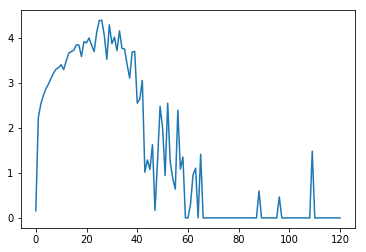

In [13]:
plt.plot(gnis_ei)

In [12]:
torch.save(gnis_net, experiment_name+'.mdl')
np.save(result_path+'/'+experiment_name+'_ei', gnis_ei)
np.save(result_path+'/'+experiment_name+'_loss', gnis_loss)
np.save(result_path+'/'+experiment_name+'_macromae', gnis_macromae)
np.save(result_path+'/'+experiment_name+'_micromae', gnis_micromae)
np.save(result_path+'/'+experiment_name+'_term1', gnis_term1)
np.save(result_path+'/'+experiment_name+'_term2', gnis_term2)
np.save(result_path+'/'+experiment_name+'_logdet', gnis_logdet)
np.save(result_path+'/'+experiment_name+'_y0_std', gnis_y0_std)
np.save(result_path+'/'+experiment_name+'_y1_std', gnis_y1_std)
np.save(result_path+'/'+experiment_name+'_p1', gnis_p1)
np.save(result_path+'/'+experiment_name+'_p2', gnis_p2)

FileNotFoundError: [Errno 2] No such file or directory: 'results_RNIS4/nice_gnis_1_500_ei.npy'

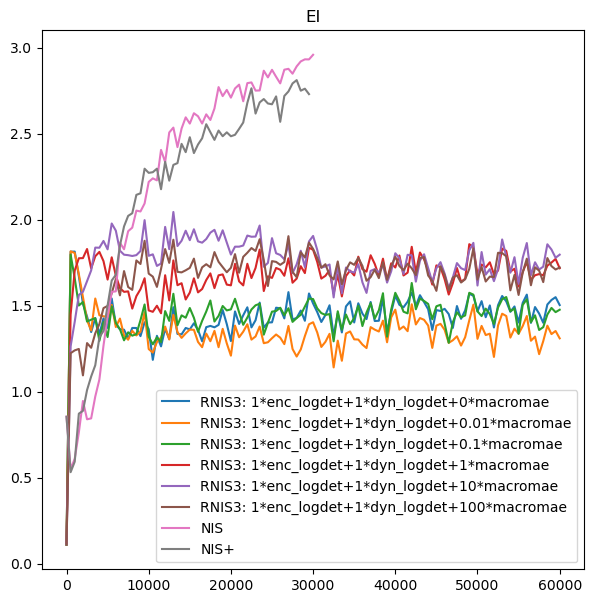

In [34]:
plt.figure(figsize=(7,7))
plt.title('EI')
plt.plot(np.arange(121)*500, np.load('results_RNIS4/nice_gnis_1_0_ei.npy'), label = 'RNIS3: 1*enc_logdet+1*dyn_logdet+0*macromae')
plt.plot(np.arange(121)*500, np.load('results_RNIS4/nice_gnis_1_0.01_ei.npy'), label = 'RNIS3: 1*enc_logdet+1*dyn_logdet+0.01*macromae')
plt.plot(np.arange(121)*500, np.load('results_RNIS4/nice_gnis_1_0.1_ei.npy'), label = 'RNIS3: 1*enc_logdet+1*dyn_logdet+0.1*macromae')
plt.plot(np.arange(121)*500, np.load('results_RNIS4/nice_gnis_1_1_ei.npy'), label = 'RNIS3: 1*enc_logdet+1*dyn_logdet+1*macromae')
plt.plot(np.arange(121)*500, np.load('results_RNIS4/nice_gnis_1_10_ei.npy'), label = 'RNIS3: 1*enc_logdet+1*dyn_logdet+10*macromae')
plt.plot(np.arange(121)*500, np.load('results_RNIS4/nice_gnis_1_100_ei.npy'), label = 'RNIS3: 1*enc_logdet+1*dyn_logdet+100*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS1/nis_ei.npy'), label = 'NIS')
plt.plot(np.arange(60)*500, np.load('results_RNIS1/nisp_ei.npy'), label = 'NIS+')
plt.legend()

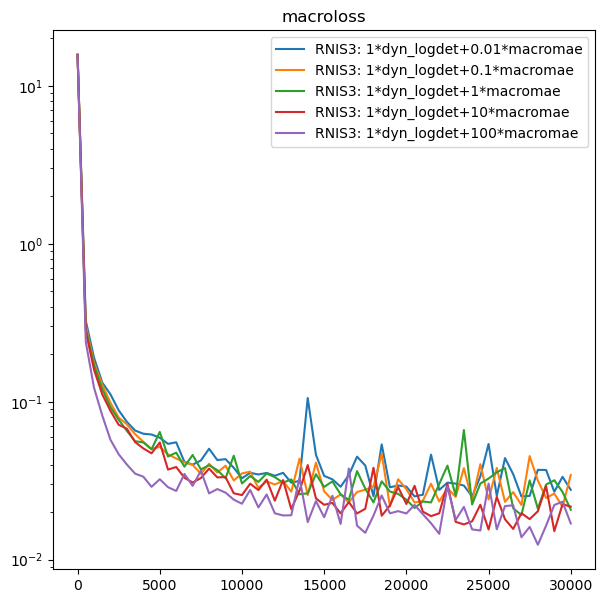

In [5]:
plt.figure(figsize=(7,7))
plt.title('macroloss')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_0.01_macromae.npy'), label = 'RNIS3: 1*dyn_logdet+0.01*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_0.1_macromae.npy'), label = 'RNIS3: 1*dyn_logdet+0.1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_1_macromae.npy'), label = 'RNIS3: 1*dyn_logdet+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_10_macromae.npy'), label = 'RNIS3: 1*dyn_logdet+10*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_100_macromae.npy'), label = 'RNIS3: 1*dyn_logdet+100*macromae')
plt.yscale('log')
plt.legend()

Text(0.5, 1.0, 'EI')

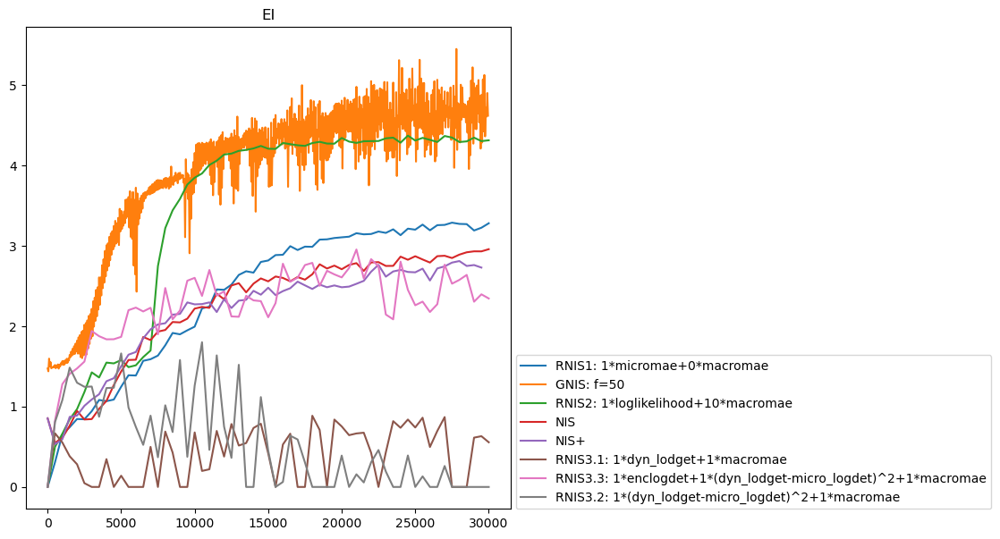

In [13]:
plt.figure(figsize=(7,7))
plt.plot(np.arange(61)*500, np.load('results_RNIS1/nice_gnis_1_0_ei.npy'), label = 'RNIS1: 1*micromae+0*macromae')
# plt.plot(np.arange(600)*50, np.load('results_RNIS2/nice_gnis_f=50_ei.npy')[:, :600].T, label = 'RNIS2: f=50')
plt.plot(np.arange(600)*50, np.load('results_GNIS_stageswitch/gnis_f=50_ei.npy')[:, :600].T, label = 'GNIS: f=50')
# plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_0.1_ei.npy'), label = 'RNIS2: 1*loglikelihood+0.1*macromae')
# plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_1_ei.npy'), label = 'RNIS2: 1*loglikelihood+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_10_ei.npy'), label = 'RNIS2: 1*loglikelihood+10*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS1/nis_ei.npy'), label = 'NIS')
plt.plot(np.arange(60)*500, np.load('results_RNIS1/nisp_ei.npy'), label = 'NIS+')
plt.plot(np.arange(61)*500, np.load('results_RNIS3/nice_gnis_1_1_ei.npy'), label = 'RNIS3.1: 1*dyn_lodget+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240426/nice_gnis_1_1_ei.npy'), label = 'RNIS3.2: 1*(dyn_lodget-micro_logdet)^2+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_1_ei.npy'), label = 'RNIS3.3: 1*enclogdet+1*(dyn_lodget-micro_logdet)^2+1*macromae')
plt.legend(loc=(1.01, 0))
plt.title('EI')

Text(0.5, 1.0, 'macro mae')

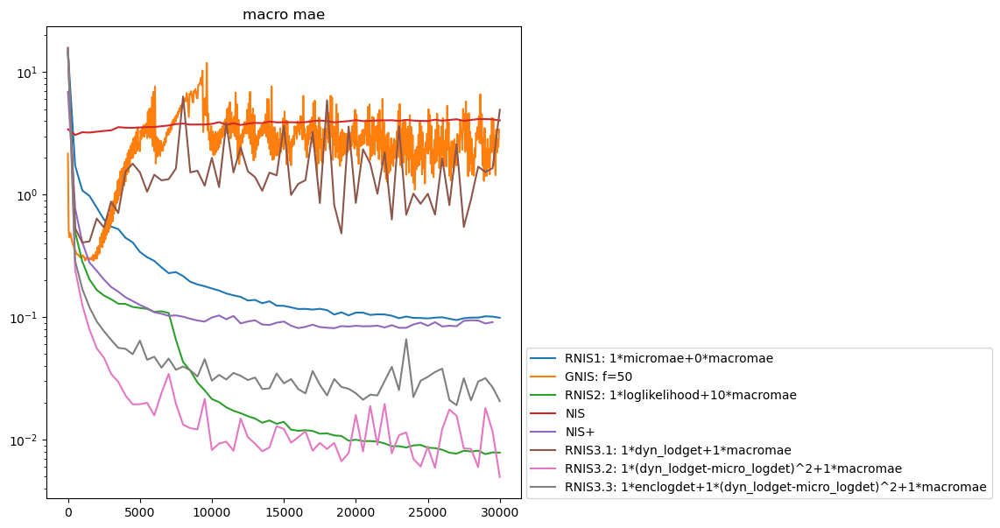

In [15]:
plt.figure(figsize=(7,7))
plt.plot(np.arange(61)*500, np.load('results_RNIS1/nice_gnis_1_0_macromae.npy'), label = 'RNIS1: 1*micromae+0*macromae')
# plt.plot(np.arange(600)*50, np.load('results_RNIS2/nice_gnis_f=50_ei.npy')[:, :600].T, label = 'RNIS2: f=50')
plt.plot(np.arange(600)*50, np.load('results_GNIS_stageswitch/gnis_f=50_macro_mae.npy')[:, :600].T, label = 'GNIS: f=50')
# plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_0.1_ei.npy'), label = 'RNIS2: 1*loglikelihood+0.1*macromae')
# plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_1_ei.npy'), label = 'RNIS2: 1*loglikelihood+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_10_macromae.npy'), label = 'RNIS2: 1*loglikelihood+10*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS1/nis_macromae.npy'), label = 'NIS')
plt.plot(np.arange(60)*500, np.load('results_RNIS1/nisp_macromae.npy'), label = 'NIS+')
plt.plot(np.arange(61)*500, np.load('results_RNIS3/nice_gnis_1_1_macromae.npy'), label = 'RNIS3.1: 1*dyn_lodget+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240426/nice_gnis_1_1_macromae.npy'), label = 'RNIS3.2: 1*(dyn_lodget-micro_logdet)^2+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_1_macromae.npy'), label = 'RNIS3.3: 1*enclogdet+1*(dyn_lodget-micro_logdet)^2+1*macromae')
plt.legend(loc=(1.01, 0))
plt.yscale('log')
plt.title('macro mae')

Text(0.5, 1.0, 'micro mae')

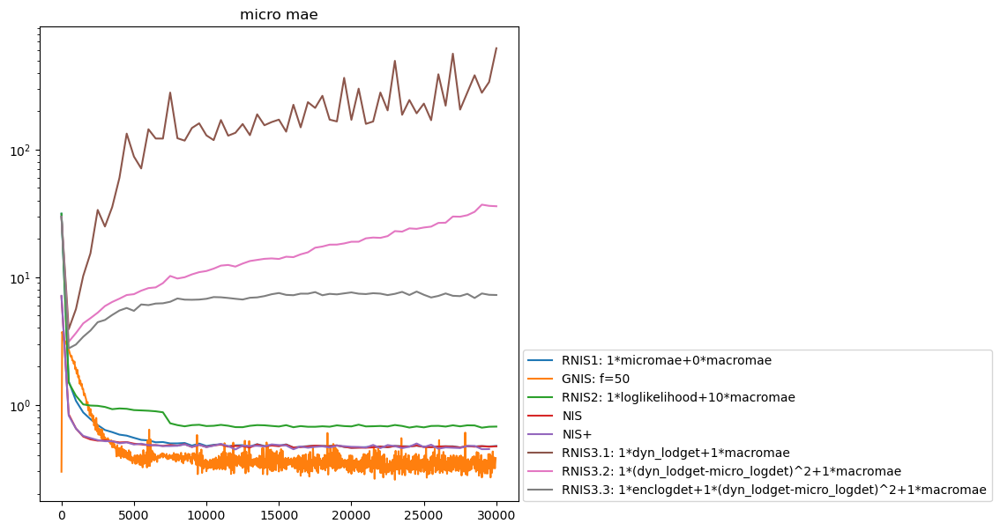

In [16]:
plt.figure(figsize=(7,7))
plt.plot(np.arange(61)*500, np.load('results_RNIS1/nice_gnis_1_0_micromae.npy'), label = 'RNIS1: 1*micromae+0*macromae')
# plt.plot(np.arange(600)*50, np.load('results_RNIS2/nice_gnis_f=50_ei.npy')[:, :600].T, label = 'RNIS2: f=50')
plt.plot(np.arange(600)*50, np.load('results_GNIS_stageswitch/gnis_f=50_micro_mae.npy')[:, :600].T, label = 'GNIS: f=50')
# plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_0.1_ei.npy'), label = 'RNIS2: 1*loglikelihood+0.1*macromae')
# plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_1_ei.npy'), label = 'RNIS2: 1*loglikelihood+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS2/nice_gnis_1_10_micromae.npy'), label = 'RNIS2: 1*loglikelihood+10*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS1/nis_micromae.npy'), label = 'NIS')
plt.plot(np.arange(60)*500, np.load('results_RNIS1/nisp_micromae.npy'), label = 'NIS+')
plt.plot(np.arange(61)*500, np.load('results_RNIS3/nice_gnis_1_1_micromae.npy'), label = 'RNIS3.1: 1*dyn_lodget+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240426/nice_gnis_1_1_micromae.npy'), label = 'RNIS3.2: 1*(dyn_lodget-micro_logdet)^2+1*macromae')
plt.plot(np.arange(61)*500, np.load('results_RNIS320240502/nice_gnis_1_1_micromae.npy'), label = 'RNIS3.3: 1*enclogdet+1*(dyn_lodget-micro_logdet)^2+1*macromae')
plt.legend(loc=(1.01, 0))
plt.yscale('log')
plt.title('micro mae')

Text(0.5, 1.0, 'rw 1*loglikelihood+10*macromae')

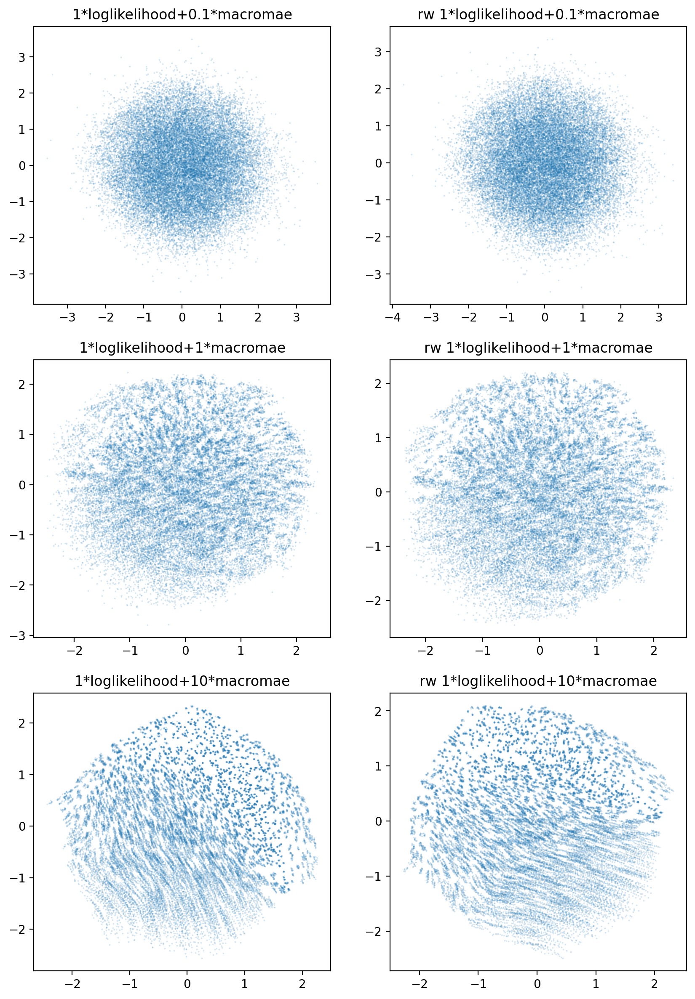

In [25]:
plt.figure(figsize=(10, 30))
gnis_net = torch.load('results_RNIS2/nice_gnis_1_0.1.mdl')
y,_,_,z = gnis_net.encode(ss)
plt.subplot(6,2,1)
z = z.cpu().detach().numpy()
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("1*loglikelihood+0.1*macromae")

gnis_net = torch.load('results_RNIS2_rw/nice_gnis_1_0.1.mdl')
y,_,_,z = gnis_net.encode(ss)
plt.subplot(6,2,2)
z = z.cpu().detach().numpy()
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("rw 1*loglikelihood+0.1*macromae")

gnis_net = torch.load('results_RNIS2/nice_gnis_1_1.mdl')
y,_,_,z = gnis_net.encode(ss)
plt.subplot(6,2,3)
z = z.cpu().detach().numpy()
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("1*loglikelihood+1*macromae")

gnis_net = torch.load('results_RNIS2_rw/nice_gnis_1_1.mdl')
y,_,_,z = gnis_net.encode(ss)
plt.subplot(6,2,4)
z = z.cpu().detach().numpy()
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("rw 1*loglikelihood+1*macromae")

gnis_net = torch.load('results_RNIS2/nice_gnis_1_10.mdl')
y,_,_,z = gnis_net.encode(ss)
plt.subplot(6,2,5)
z = z.cpu().detach().numpy()
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("1*loglikelihood+10*macromae")

gnis_net = torch.load('results_RNIS2_rw/nice_gnis_1_10.mdl')
y,_,_,z = gnis_net.encode(ss)
plt.subplot(6,2,6)
z = z.cpu().detach().numpy()
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("rw 1*loglikelihood+10*macromae")

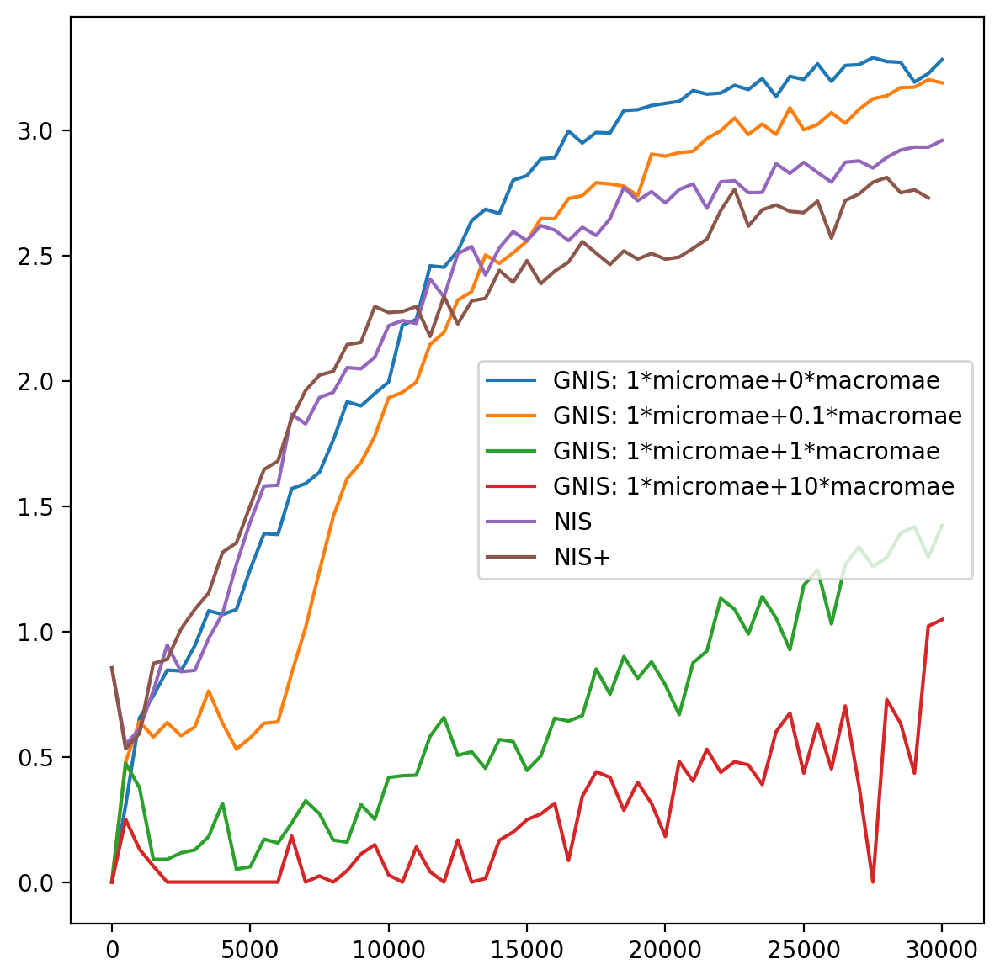

In [77]:
# old_gnis_ei = gnis_ei
plt.figure(figsize=(7,7))
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_0_ei.npy'), label = 'GNIS: 1*micromae+0*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_0.1_ei.npy'), label = 'GNIS: 1*micromae+0.1*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_1_ei.npy'), label = 'GNIS: 1*micromae+1*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_10_ei.npy'), label = 'GNIS: 1*micromae+10*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nis_ei.npy'), label = 'NIS')
plt.plot(np.arange(60)*500, np.load('results4/nisp_ei.npy'), label = 'NIS+')
plt.legend()

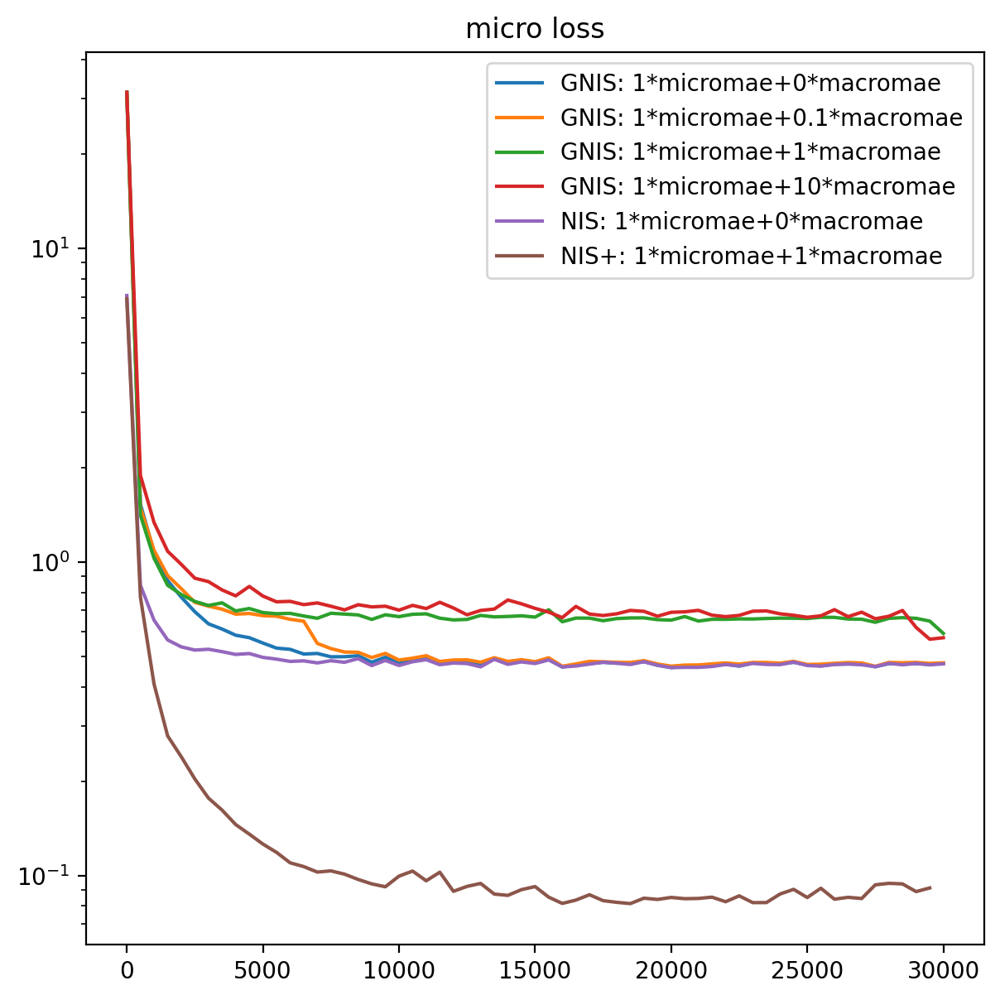

In [78]:
plt.figure(figsize=(7,7))
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_0_micromae.npy'), label = 'GNIS: 1*micromae+0*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_0.1_micromae.npy'), label = 'GNIS: 1*micromae+0.1*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_1_micromae.npy'), label = 'GNIS: 1*micromae+1*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_10_micromae.npy'), label = 'GNIS: 1*micromae+10*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nis_loss.npy').T, label = 'NIS: 1*micromae+0*macromae')
plt.plot(np.arange(60)*500, np.load('results4/nisp_macromae.npy'), label = 'NIS+: 1*micromae+1*macromae')
plt.title('micro loss')
plt.yscale('log')
plt.legend()

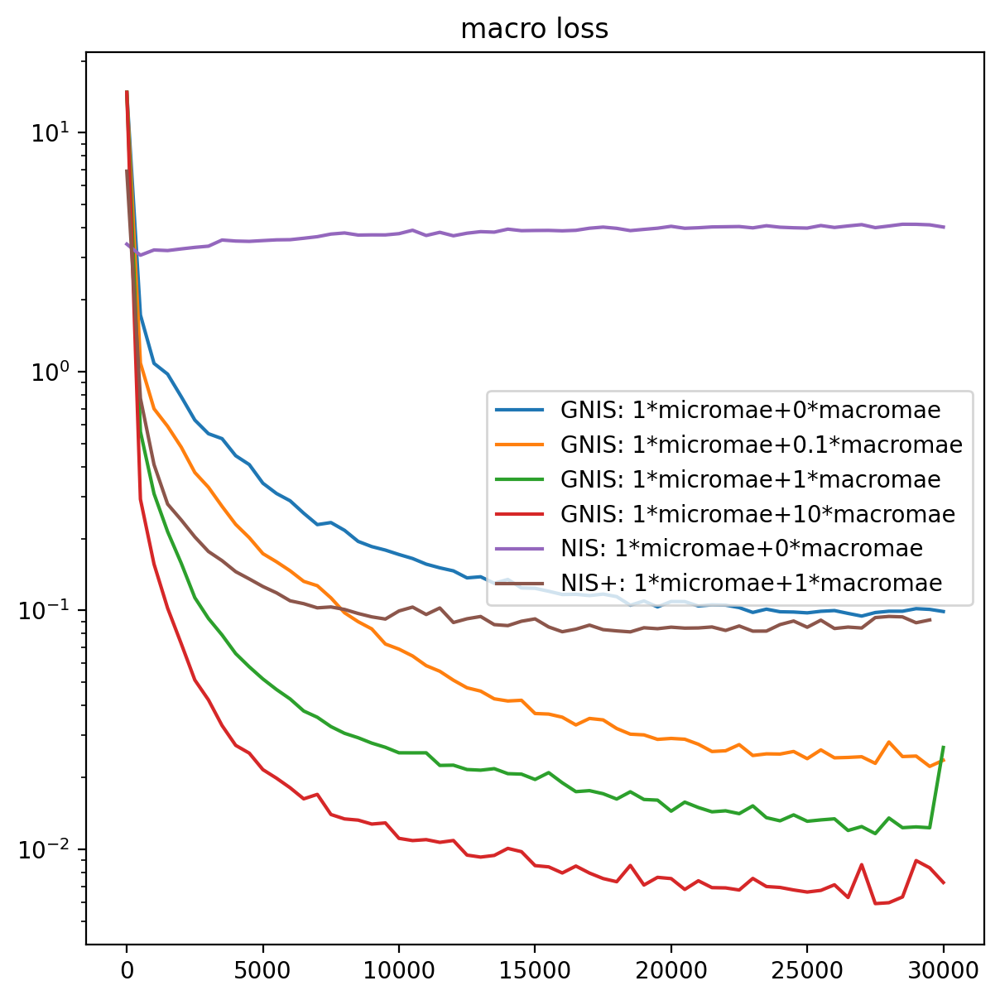

In [79]:
plt.figure(figsize=(7,7))
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_0_macromae.npy'), label = 'GNIS: 1*micromae+0*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_0.1_macromae.npy'), label = 'GNIS: 1*micromae+0.1*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_1_macromae.npy'), label = 'GNIS: 1*micromae+1*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nice_gnis_1_10_macromae.npy'), label = 'GNIS: 1*micromae+10*macromae')
plt.plot(np.arange(61)*500, np.load('results4/nis_macromae.npy').T, label = 'NIS: 1*micromae+0*macromae')
plt.plot(np.arange(60)*500, np.load('results4/nisp_macromae.npy'), label = 'NIS+: 1*micromae+1*macromae')
plt.title('macro loss')
plt.yscale('log')
plt.legend()

In [54]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters())
count_parameters(gnis_net), count_parameters(nis_net), count_parameters(nisp_net)

(11200, 13282, 17764)

—— —— —— Invertible map —— —— ——


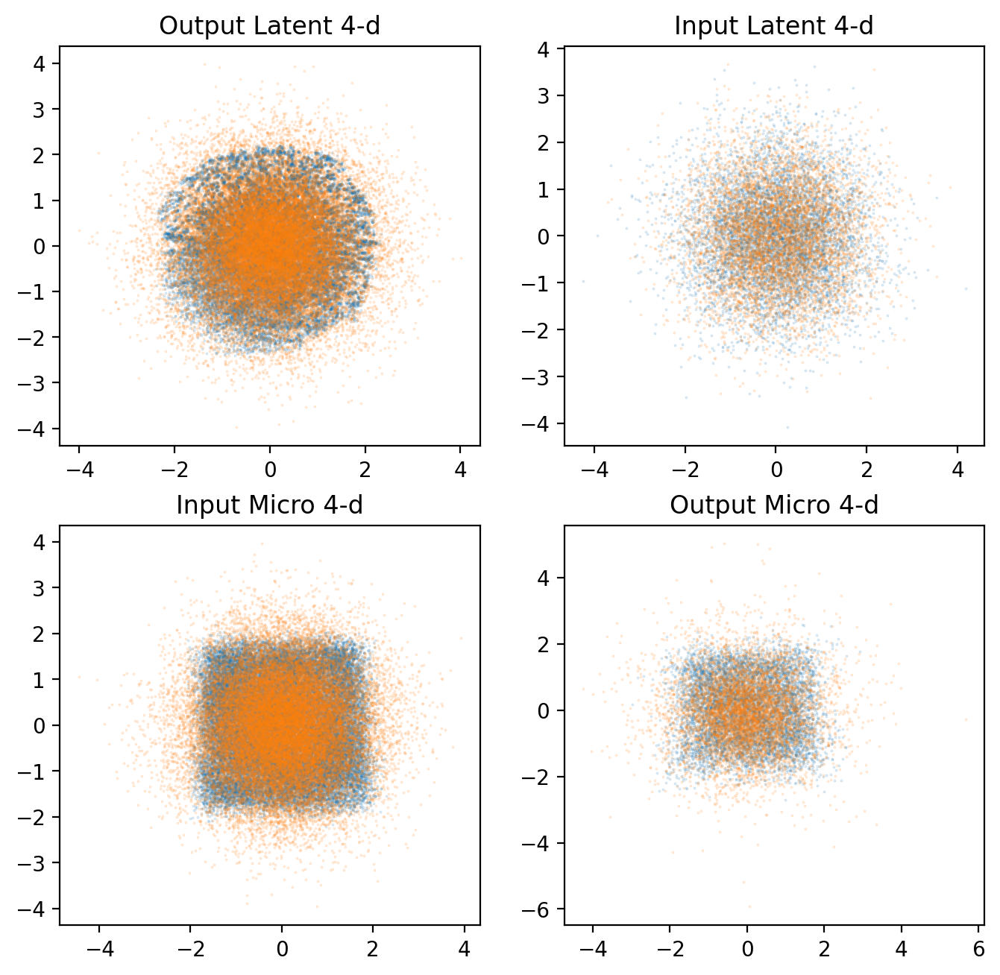

In [17]:
def generate_plot(net_npp,latent_bool=True):
    rcParams['figure.figsize'] = 8, 16
    rcParams['figure.dpi'] = 200
    disp_digits = 6

    y,_,_,z = net_npp.encode(ss)
    #o3 = net_npp.dynamics(o1) + o1
    #o4,o5 = net_npp.decoding1(o3)

    print("—— —— —— Invertible map —— —— ——")
    if latent_bool:
        plt.subplot(4,2,1)
        z = z.cpu().detach().numpy()
        y = y.cpu().detach().numpy()
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(z[:, 2], z[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Output Latent 4-d")

        z = np.random.multivariate_normal(np.zeros(4), np.eye(4), 7000)
        plt.subplot(4,2,2)
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(z[:, 2], z[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Input Latent 4-d")

        plt.subplot(4,2,3)
        x = ss.cpu().detach().numpy()
        plt.scatter(x[:, 0], x[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(x[:, 2], x[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Input Micro 4-d")

        plt.subplot(4,2,4)
        z = distributions.MultivariateNormal(torch.zeros(4,device=device), torch.eye(4,device=device)).sample((7000, 1))[:,0]
        x = net_npp.encoder.inverse(z)
        x = x.cpu().detach().numpy()
        plt.scatter(x[:,0], x[:,1],s= 0.1,alpha = 0.25)
        plt.scatter(x[:,2], x[:,3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Output Micro 4-d")
        
    else:
        rcParams['figure.figsize'] = 8, 4
        rcParams['figure.dpi'] = 200
        plt.subplot(1,2,1)
        z1 = o1.cpu().detach().numpy()
        z2 = o2.cpu().detach().numpy()
        plt.scatter(z1[:, 0], z1[:, 1],s= 0.1,alpha = 0.25)
        plt.title("Output Latent 2-d")

        z = np.random.multivariate_normal(np.zeros(4), np.eye(4), 7000)
        plt.subplot(1,2,2)
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.title("Input Latent 2-d")
#测试GNIS的隐空间
generate_plot(gnis_net,latent_bool=True)

—— —— —— Invertible map —— —— ——


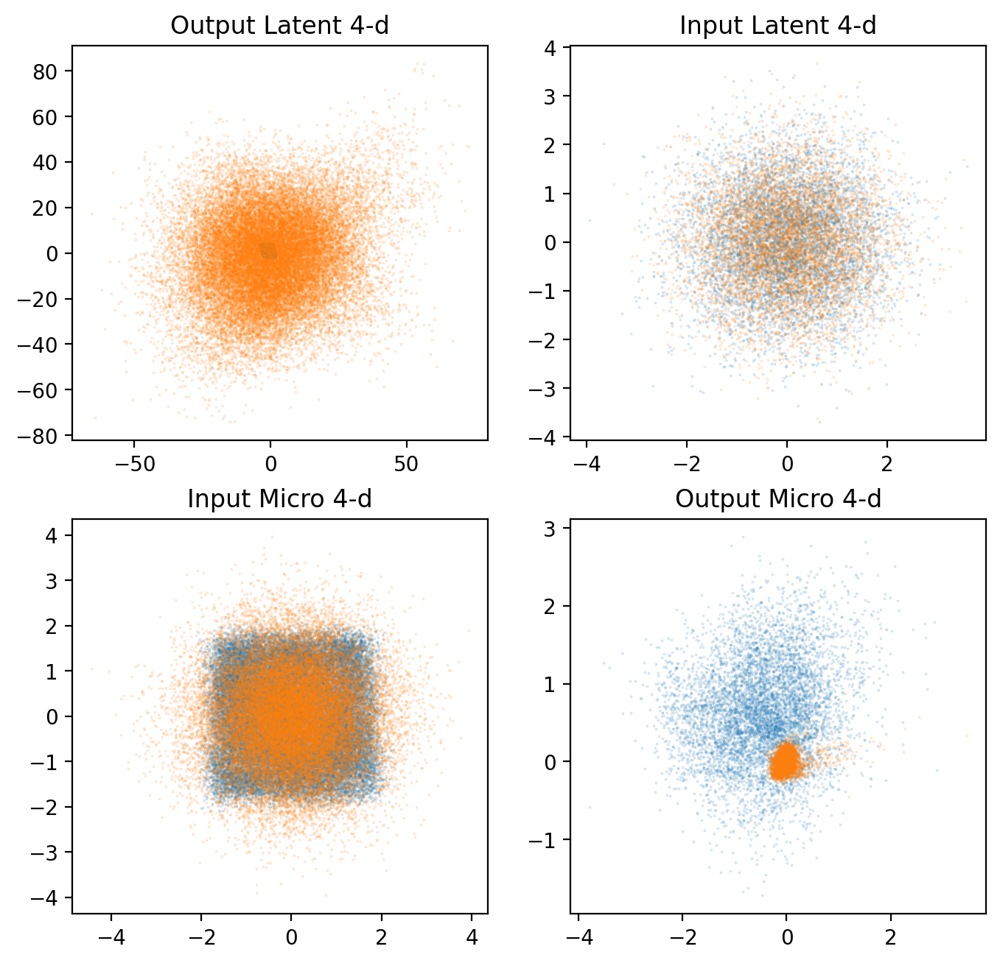

In [89]:
# gnis_net = torch.load('results4/nice_gnis_1_0.mdl')
# generate_plot(gnis_net,latent_bool=True)
# gnis_net = torch.load('results4/nice_gnis_1_0.1.mdl')
# generate_plot(gnis_net,latent_bool=True)
# gnis_net = torch.load('results4/nice_gnis_1_1.mdl')
# generate_plot(gnis_net,latent_bool=True)
# gnis_net = torch.load('results4/nice_gnis_1_10.mdl')
# generate_plot(gnis_net,latent_bool=True)
# generate_plot(nis_net,latent_bool=True)
# generate_plot(nisp_net,latent_bool=True)

Text(0.5, 1.0, '$y_{t+1}$ and  yhat_{t+1}} for GNIS (1, 1)')

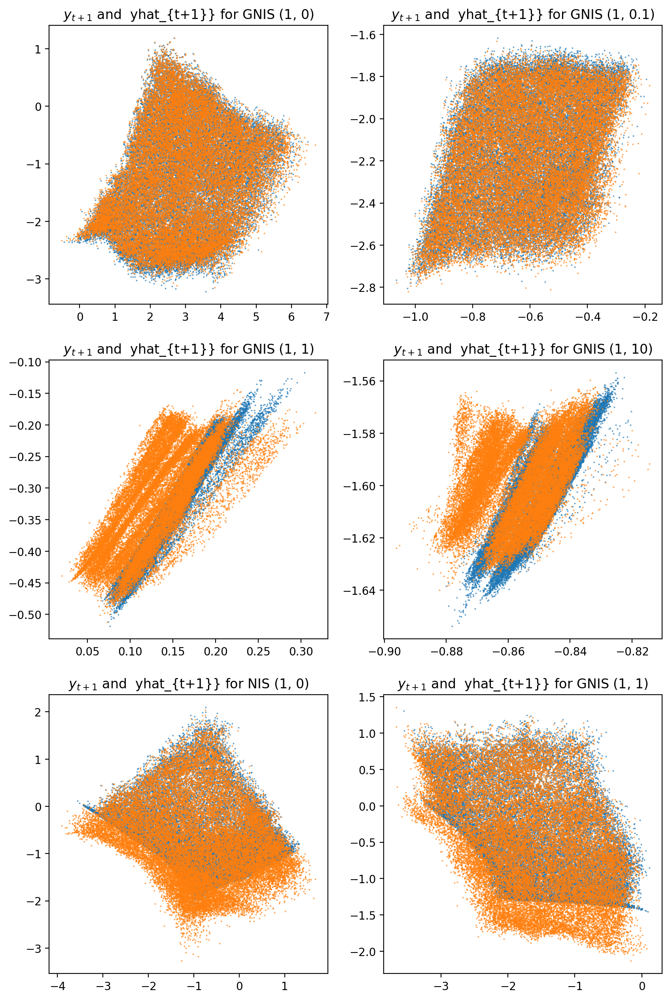

In [108]:
ss, sps, ls, lps = generate_lv_rand(size=train_size, steps=steps,
                                    lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                    sigma=sigma, rou=rou, alpha=0.3,
                                    gamma=1, beta=0.2, e=0.2, dt=0.01)
plt.figure(figsize=(10,32))
plt.subplot(6, 2, 1)
gnis_net = torch.load('results4/nice_gnis_1_0.mdl')
predicts, latentp, latent, logp, logdet, z = gnis_net(ss)
y_next, _,_,_ = gnis_net.encode(sps)
latentp = latentp.detach().numpy()
y_next = y_next.detach().numpy()
plt.scatter(latentp[:,0], latentp[:,1], s = 0.1)
plt.scatter(y_next[:,0], y_next[:,1], s= 0.1)
plt.title('$y_{t+1}$ and  yhat_{t+1}} for GNIS (1, 0)')

plt.subplot(6, 2, 2)
gnis_net = torch.load('results4/nice_gnis_1_0.1.mdl')
predicts, latentp, latent, logp, logdet, z = gnis_net(ss)
y_next, _,_,_ = gnis_net.encode(sps)
latentp = latentp.detach().numpy()
y_next = y_next.detach().numpy()
plt.scatter(latentp[:,0], latentp[:,1], s = 0.1)
plt.scatter(y_next[:,0], y_next[:,1], s= 0.1)
plt.title('$y_{t+1}$ and  yhat_{t+1}} for GNIS (1, 0.1)')

plt.subplot(6, 2, 3)
gnis_net = torch.load('results4/nice_gnis_1_1.mdl')
predicts, latentp, latent, logp, logdet, z = gnis_net(ss)
y_next, _,_,_ = gnis_net.encode(sps)
latentp = latentp.detach().numpy()
y_next = y_next.detach().numpy()
plt.scatter(latentp[:,0], latentp[:,1], s = 0.1)
plt.scatter(y_next[:,0], y_next[:,1], s= 0.1)
plt.title('$y_{t+1}$ and  yhat_{t+1}} for GNIS (1, 1)')

plt.subplot(6, 2, 4)
gnis_net = torch.load('results4/nice_gnis_1_10.mdl')
predicts, latentp, latent, logp, logdet, z = gnis_net(ss)
y_next, _,_,_ = gnis_net.encode(sps)
latentp = latentp.detach().numpy()
y_next = y_next.detach().numpy()
plt.scatter(latentp[:,0], latentp[:,1], s = 0.1)
plt.scatter(y_next[:,0], y_next[:,1], s= 0.1)
plt.title('$y_{t+1}$ and  yhat_{t+1}} for GNIS (1, 10)')

plt.subplot(6, 2, 5)
gnis_net = torch.load('results4/nis.mdl')
predicts, latentp, latent, logp, logdet, z = gnis_net(ss)
y_next, _,_,_ = gnis_net.encode(sps)
latentp = latentp.detach().numpy()
y_next = y_next.detach().numpy()
plt.scatter(latentp[:,0], latentp[:,1], s = 0.1)
plt.scatter(y_next[:,0], y_next[:,1], s= 0.1)
plt.title('$y_{t+1}$ and  yhat_{t+1}} for NIS (1, 0)')

plt.subplot(6, 2, 6)
gnis_net = torch.load('results4/nisp.mdl')
predicts, latentp, latent, logp, logdet, z = gnis_net(ss)
y_next, _,_,_ = gnis_net.encode(sps)
latentp = latentp.detach().numpy()
y_next = y_next.detach().numpy()
plt.scatter(latentp[:,0], latentp[:,1], s = 0.1)
plt.scatter(y_next[:,0], y_next[:,1], s= 0.1)
plt.title('$y_{t+1}$ and  yhat_{t+1}} for GNIS (1, 1)')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


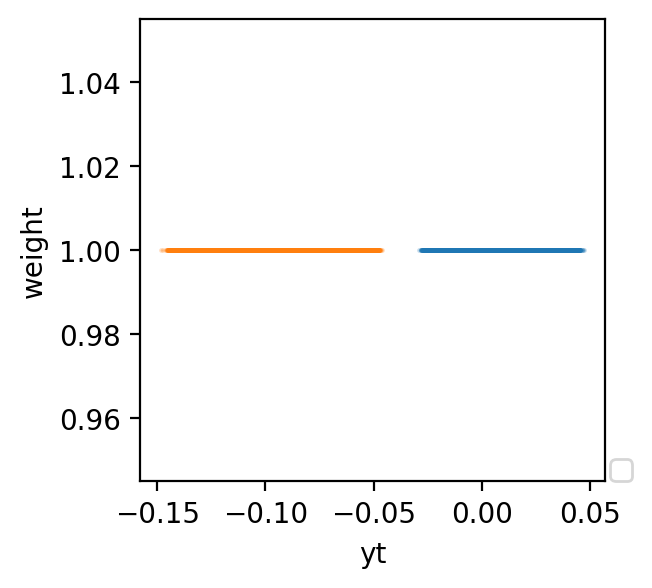

In [ ]:
cut = 1
plt.figure(figsize=(3,3))
encodings,_,_,_ = gnis_net.encode(ss)  
plt.scatter(encodings[:,0].cpu().detach().numpy(),weights.cpu().numpy(),s=0.5,alpha=0.25)
plt.scatter(encodings[:,1].cpu().detach().numpy(),weights.cpu().numpy(),s=0.5,alpha=0.25)
plt.ylabel('weight')
plt.xlabel('yt')
# plt.plot(gnis_ei_list[0,cut:], label = 'ei')
# plt.plot(gnis_loss_list[0,cut:], label = 'loss')
# plt.plot(gnis_term1[0,cut:], label='determ')
# plt.plot(gnis_term2[0,cut:], label='degene')
# plt.plot( p1_list[0,cut:], label = 'p1')
# plt.plot( p2_list[0,cut:], label = 'p2')
# plt.ylim([0,0.1])
# plt.plot(nis_ei, label = 'nis_ei')
# plt.plot(nis_term1, label='nis_determ')
# plt.plot(nis_term2, label='nis_degene')
plt.legend(loc = [1.01,0])

In [55]:
class NIS(nn.Module):
    def __init__(self, sz, scale, hidden_units, device,
                    inn_hidden = 4, length = 2, inn = 'NICE', interval = 20):
        super(NIS, self).__init__()
        
        self.device = device
        net = lambda: INN.Nonlinear(sz, inn, k = inn_hidden)
        jac_lin = lambda: INN.JacobianLinear(sz, sz)#, k = inn_hidden)
        self.nets = [net() for _ in range(interval*(length-1))]
        self.jacs = [jac_lin() for _ in range(interval)]
        self.encoder = INN.Sequential(*[self.jacs[i//length] if i % length == (length-1)
                                        else self.nets[i//length*(length-1) + i%length]
                                        for i in range(interval*length)])
        self.projector = INN.ResizeFeatures(sz, scale)

        self.dynamics = nn.Sequential(nn.Linear(scale, hidden_units), nn.LeakyReLU(), 
                                    nn.Linear(hidden_units, hidden_units), nn.LeakyReLU(), 
                                    nn.Linear(hidden_units, scale))
        
        # nice_dyn = lambda: INN.Nonlinear(scale, inn, k = inn_hidden)
        # self.dyn_nice = [nice_dyn() for _ in range(interval*(length-1))]
        # jac_dyn = lambda: INN.JacobianLinear(scale, scale)#, k = inn_hidden)
        # self.dyn_jac = [jac_dyn() for _ in range(interval)]
        # self.dynamics = INN.Sequential(*[self.dyn_jac[i//length] if i % length == (length-1)
        #                                 else self.dyn_nice[i//length*(length-1) + i%length]
        #                                 for i in range(interval*length)])

        # nice_dyn = lambda: INN.Nonlinear(scale, inn, k = inn_hidden)
        # self.dyn_nice = [nice_dyn() for _ in range(interval)]
        # self.dynamics = INN.Sequential(*self.dyn_nice)

        
    def encode(self, x):
        z, logp, logdet = self.encoder(x)
        y, _, _ = self.projector(z)
        return y, logp, logdet, z
    
    def decode(self, y):
        x = self.projector.inverse(y)
        x = self.encoder.inverse(x)
        return x
    
    def forward(self, x):
        if len(x.size())<=1:
            x = x.unsqueeze(0)
        y, logp, logdet, z = self.encode(x)
        y_next = self.dynamics(y) + y
#         y_next = (y_next - torch.mean(y_next)) / torch.std(y_next)
        x_next = self.decode(y_next)
        return x_next, y_next, y, logp, logdet, z
    

def test_model_causal_multi_sis(spring_data,  MAE_raw, MSE_raw,
                                net1, sigma, scale,
                                num_samples, bigL=100):
    #EI calculation function
    sigmas_matrix = torch.zeros([2,2],device=device)
    s,sp,l,lp=spring_data
    samples = s.size()[0]
    s, sp = transform(s, sp, num_samples)
    encode,_,_,_ = net1.encode(sp)
    predicts1, latentp1, latent1, _, _, _ = net1(s)
    data = torch.cat((encode,latent1[-num_samples:,:]),0)
    std_values = torch.std(data, dim = 0) 
    L_list = 5 * std_values
    log_density, k_model_n = kde_density(latent1)
    log_rho = - torch.sum(torch.log(2.0 * L_list)).cpu().detach()  #Uniform distribution probability distribution
    logp = log_rho - log_density  #The difference between two probability distributions.
    weights = to_weights(logp, temperature) * samples
    if use_cuda:
        weights = weights.cuda(device=device)
    weights = weights.unsqueeze(1)
    me = 'mse'
    mae1 = MSE_raw(latentp1, encode) * torch.cat((weights,weights),1)
    if (me == 'mae'):
        mae1 = MAE_raw(latentp1, encode) * torch.cat((weights,weights),1)
    sigmas = mae1.mean(axis=0)
    data_scale=torch.std(encode)
    # sigmas=sigmas/data_scale
    sigmas_matrix = torch.diag(sigmas)
    # ei = approx_ei(scale, scale, sigmas_matrix.data, lambda x:(net1.dynamics(x.unsqueeze(0))+x.unsqueeze(0)), 
    #                    num_samples = num_samples, L = L_list, easy=True, device=device) 
    ei = approx_ei(scale, scale, sigmas_matrix.data, lambda x:(net1.dynamics(x.unsqueeze(0))+x.unsqueeze(0)), 
                       num_samples = num_samples, L = L_list, easy=True, device=device) 

    return ei, sigmas,weights

In [56]:
#nis
results_nis = []
temperature = 1
experiments = 1
sz = 4
scale = 2
L = 5
steps = 10
hidden_units = 64
MAE = torch.nn.L1Loss()
MAE_raw = torch.nn.L1Loss(reduction='none')
prior = distributions.MultivariateNormal(torch.zeros(sz,device=device), torch.eye(sz,device=device))
test_start = 0
test_end = 0.3
m_step = 10
mul_batch_size = [15000,15000]
T2 = 30000

rou = -0.5

nis_logdet = []
nis_ei = []
nis_macromae = []
nis_micromae = []
nis_y0_std = []
nis_y1_std = []
nis_term1 = []
nis_term2 = []

nis_ei_list = np.zeros([experiments,int(T2/500+1)])
nis_loss_list = np.zeros([experiments,int(T2/500+1)])
nis_ood_test = np.zeros([experiments,int(T2/500+1)])

#nis_ood_test = []

for experiment in range(experiments):
    seed = 1 + experiment
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    ss, sps, ls, lps = generate_lv_rand(size=train_size, steps=10,
                                        lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                        sigma=sigma, rou=rou, alpha=0.3,
                                        gamma=1, beta=0.2, e=0.2, dt=0.01)
    samples_for_ei = generate_lv_rand(size=test_size, steps=10,
                                        lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                        sigma=sigma, rou=rou, alpha=0.3,
                                        gamma=1, beta=0.2, e=0.2, dt=0.01)
    sample_num = ss.size()[0] 
    ss, sps = transform(ss, sps, train_size)

    nis_net = NIS(sz=sz, scale=scale,
                    hidden_units=hidden_units, device=device,
                    length=2, inn='NICE', interval=20)   
    nis_net.to(device=device)
    
    optimizer2 = torch.optim.Adam([p for p in nis_net.parameters() if p.requires_grad==True], lr=1e-4)    
    result_nn = []
    ei_nn=[]
    term1_nn=[]
    term2_nn=[]
    losses_nn=[]

    cpt('out')
    # seed = 1 + experiment
    # np.random.seed(seed)
    # torch.manual_seed(seed)
    # torch.cuda.manual_seed_all(seed)
    for epoch in range(T2+1):
        start = np.random.randint(ss.size()[0]-batch_size)
        end = start + batch_size
        s, sp, l, lp = ss[start:end], sps[start:end], ls[start:end], lps[start:end]
        
        predicts, latentp, latent, logp, logdet, z = nis_net(s)
        mae = MAE(sp, predicts)
        y_next, _,_,_ = gnis_net.encode(sp)
        mae2 = MAE(y_next,latentp)
        # loglikelihood = -prior.log_prob(z).mean()-logdet.mean()
        loss_nn = mae
        optimizer2.zero_grad()
        loss_nn.backward()
        optimizer2.step()

        if epoch % 500 == 0:
            cpt('o_0')
            print(experiment, '/', experiments, 'Epoch:', epoch)
            
            ei1, sigmas1, weightsnn = test_model_causal_multi_sis(samples_for_ei, MAE_raw, MSE_raw, nis_net, sigma, scale, num_samples=test_size, bigL=L)
            s1, sp1, _,_ = generate_lv_test(size=test_size, steps=10,
                                            lb_u=0, ub_u=2, lb_v=0, ub_v=2,
                                            sigma=0.1, rou=rou, alpha=0.3, gamma=1, beta=0.2, e=0.2, dt=0.01) #sir
            s1, sp1 = transform(s1, sp1, test_size)
            predicts1, _,_,_,_,_ = nis_net(s1)
            mae_test = MAE(sp1, predicts1)#/torch.std(sps)
            print('Train loss: CommonNet= %.4f' %  mae.item())
            print('Test loss: CommonNet= %.4f' %  mae_test.item())
            print('logdet: %.4f'% logdet.mean().item())
            print('dEI: CommonNet= %.4f' % ei1[0])
            print('term1: CommonNet= %.4f'% ei1[3])
            print('term2: CommonNet= %.4f'% ei1[4])
            print(120*'-')

            nis_ei_list[experiment,int(epoch/500)] = ei1[0]
            nis_term1.append(ei1[3].item())
            nis_term2.append(ei1[4].item())
            #nis_ood_test.append(mae_test.item())
            nis_loss_list[experiment,int(epoch/500)] = mae.item()
            nis_ood_test[experiment,int(epoch/500)] = mae_test.item()
            result_nn.append([ei1[0], ei1[3].item(), ei1[4].item(),loss_nn.item()])
            nis_micromae.append(mae.item())
            nis_macromae.append(mae2.item())
            y, _, logdet, _ = nis_net.encode(s)
            nis_ei.append(ei1[0])
            nis_y0_std.append(y[:, 0].std().item())
            nis_y1_std.append(y[:, 1].std().item())
            nis_logdet.append(logdet.mean().item())
            cpt('o_1')

    results_nis.append(result_nn)

check point-------out-> 02:52:43.176669; lasting 0:02:14.372894 seconds
check point-------o_0-> 02:52:43.277302; lasting 0:00:00.100633 seconds
0 / 1 Epoch: 0
Train loss: CommonNet= 7.0720
Test loss: CommonNet= 6.5803
logdet: -0.0000
dEI: CommonNet= 0.8548
term1: CommonNet= -5.4499
term2: CommonNet= 7.1594
------------------------------------------------------------------------------------------------------------------------
check point-------o_1-> 02:52:43.429937; lasting 0:00:00.152635 seconds
check point-------o_0-> 02:53:18.747218; lasting 0:00:35.317281 seconds
0 / 1 Epoch: 500
Train loss: CommonNet= 0.8428
Test loss: CommonNet= 0.8520
logdet: 0.7741
dEI: CommonNet= 0.5495
term1: CommonNet= -2.5445
term2: CommonNet= 3.6435
------------------------------------------------------------------------------------------------------------------------
check point-------o_1-> 02:53:18.883314; lasting 0:00:00.136096 seconds
check point-------o_0-> 02:53:54.705113; lasting 0:00:35.821799 secon

In [57]:
torch.save(nis_net, result_path+'/nis.mdl')
np.save(result_path+'/nis_ei', nis_ei)
nis_loss = nis_loss_list
np.save(result_path+'/nis_loss', nis_loss)
np.save(result_path+'/nis_micromae', nis_micromae)
np.save(result_path+'/nis_macromae', nis_macromae)
np.save(result_path+'/nis_term1', nis_term1)
np.save(result_path+'/nis_term2', nis_term2)
np.save(result_path+'/nis_logdet', nis_logdet)
np.save(result_path+'/nis_y0_std', nis_y0_std)
np.save(result_path+'/nis_y1_std', nis_y1_std)

—— —— —— Invertible map —— —— ——


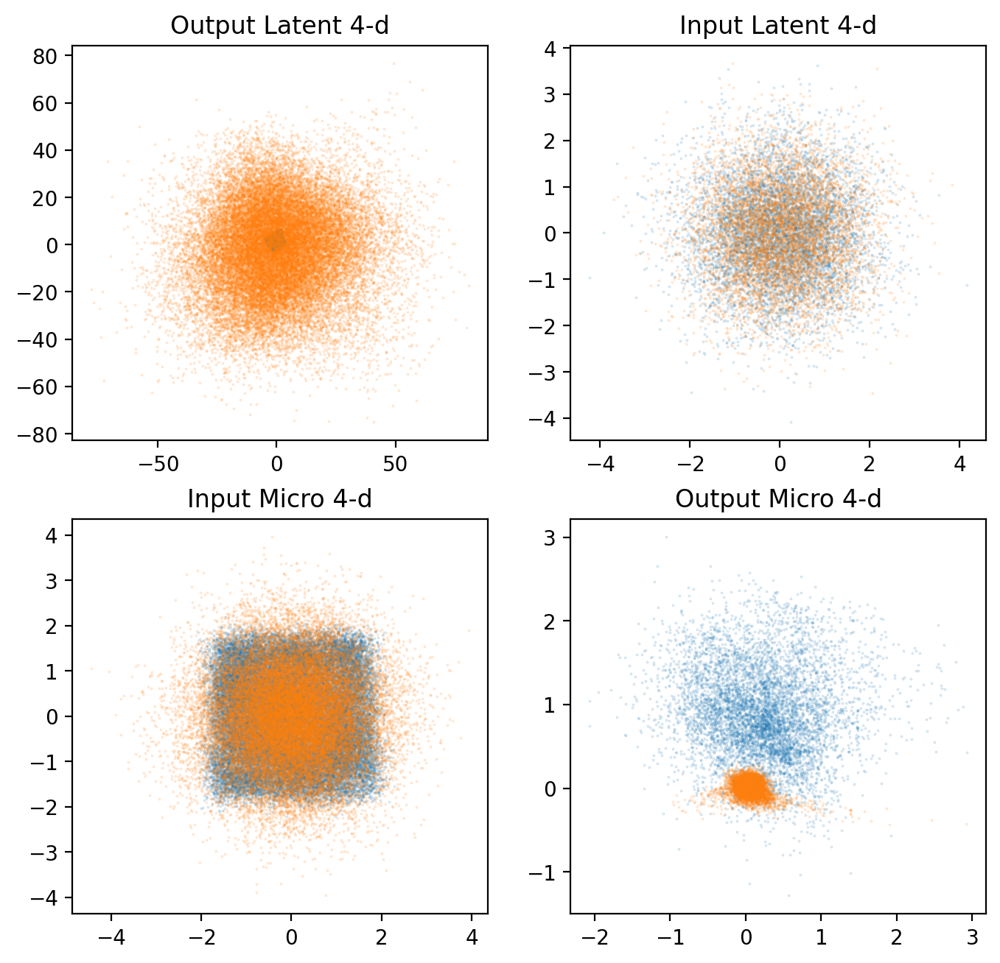

In [58]:
def generate_plot(net_npp,latent_bool=True):
    rcParams['figure.figsize'] = 8, 16
    rcParams['figure.dpi'] = 200
    disp_digits = 6

    y,_,_,z = net_npp.encode(ss)
    #o3 = net_npp.dynamics(o1) + o1
    #o4,o5 = net_npp.decoding1(o3)

    print("—— —— —— Invertible map —— —— ——")
    if latent_bool:
        plt.subplot(4,2,1)
        z = z.cpu().detach().numpy()
        y = y.cpu().detach().numpy()
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(z[:, 2], z[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Output Latent 4-d")

        z = np.random.multivariate_normal(np.zeros(4), np.eye(4), 7000)
        plt.subplot(4,2,2)
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(z[:, 2], z[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Input Latent 4-d")

        plt.subplot(4,2,3)
        x = ss.cpu().detach().numpy()
        plt.scatter(x[:, 0], x[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(x[:, 2], x[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Input Micro 4-d")

        plt.subplot(4,2,4)
        z = distributions.MultivariateNormal(torch.zeros(4,device=device), torch.eye(4,device=device)).sample((7000, 1))[:,0]
        x = net_npp.encoder.inverse(z)
        x = x.cpu().detach().numpy()
        plt.scatter(x[:,0], x[:,1],s= 0.1,alpha = 0.25)
        plt.scatter(x[:,2], x[:,3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Output Micro 4-d")
    else:
        rcParams['figure.figsize'] = 8, 4
        rcParams['figure.dpi'] = 200
        plt.subplot(1,2,1)
        z1 = o1.cpu().detach().numpy()
        z2 = o2.cpu().detach().numpy()
        plt.scatter(z1[:, 0], z1[:, 1],s= 0.1,alpha = 0.25)
        plt.title("Output Latent 2-d")

        z = np.random.multivariate_normal(np.zeros(4), np.eye(4), 7000)
        plt.subplot(1,2,2)
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.title("Input Latent 2-d")
#测试GNIS的隐空间
generate_plot(nis_net, latent_bool=True)

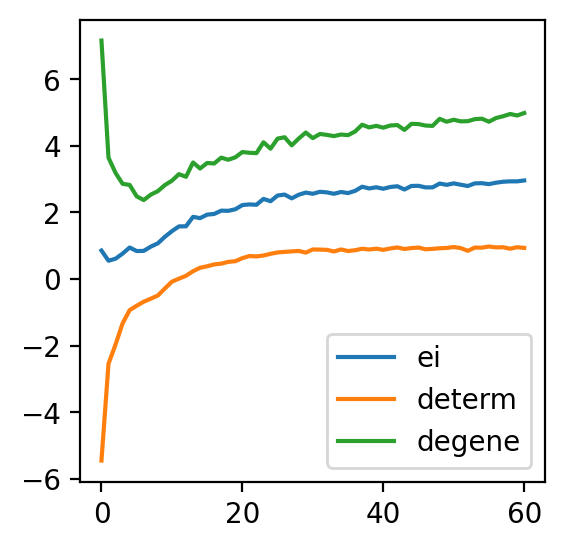

In [59]:
plt.figure(figsize=(3,3))
# plt.plot(nis_y0_std, label='y0_std')
# plt.plot(nis_y1_std, label='y1_std')
# plt.plot(nis_logdet, label='logdet')
# plt.plot(gnis_loss)
plt.plot(nis_ei, label = 'ei')
plt.plot(nis_term1, label='determ')
plt.plot(nis_term2, label='degene')
plt.legend()

In [60]:
class NISPLUS(nn.Module):
    def __init__(self, sz, scale, hidden_units, device,
                    inn_hidden = 4, length = 2, inn = 'NICE', interval = 20,
                    normalized_state=False, is_random=False):
        super(NISPLUS, self).__init__()
        self.normalized_state = normalized_state
        self.is_random = is_random        
        self.device = device
        net = lambda: INN.Nonlinear(sz, inn)
        jac_lin = lambda: INN.JacobianLinear(sz, sz)
        self.nets = [net() for _ in range(interval*(length-1))]
        self.jacs = [jac_lin() for _ in range(interval)]
        self.encoder = INN.Sequential(*[self.jacs[i//length] if i % length == (length-1)
                                        else self.nets[i//length*(length-1) + i%length]
                                        for i in range(interval*length)])
        self.projector = INN.ResizeFeatures(sz, scale)
        
        self.dynamics = nn.Sequential(nn.Linear(scale, hidden_units),
                                        nn.LeakyReLU(), 
                                        nn.Linear(hidden_units, hidden_units),
                                        nn.LeakyReLU(), 
                                        nn.Linear(hidden_units, scale))
        self.inv_dynamics = nn.Sequential(nn.Linear(scale, hidden_units),
                                            nn.LeakyReLU(),
                                            nn.Linear(hidden_units, hidden_units),
                                            nn.LeakyReLU(), 
                                            nn.Linear(hidden_units, scale))
        
    def encode(self, x):
        z, logp, logdet = self.encoder(x)
        y, _, _ = self.projector(z)
        return y, logp, logdet, z
    
    def decode(self, y):
        x = self.projector.inverse(y)
        x = self.encoder.inverse(x)
        return x
    
    def forward(self, x):
        if len(x.size())<=1:
            x = x.unsqueeze(0)
        y, logp, logdet, z = self.encode(x)
        y_next = self.dynamics(y) + y
        x_next = self.decode(y_next)
        return x_next, y_next, y, logp, logdet, z
    
    def back_forward(self, x):
        if len(x.size())<=1:
            x = x.unsqueeze(0)
        s, _, _, _ = self.encode(x)
        s_prev = self.inv_dynamics(s) - s
        if self.is_random:
            s_prev = s_prev + torch.relu(self.sigmas.repeat(s_prev.size()[0],1)) * torch.randn(s_prev.size(), device=self.device)
        y = self.decode(s_prev)
        return y, s, s_prev



In [61]:
#nis+
results_nisplus = []
temperature = 1
experiments = 1
sz = 4
scale = 2
L = 5
steps = 10
hidden_units = 64
MAE = torch.nn.L1Loss()
MAE_raw = torch.nn.L1Loss(reduction='none')
prior = distributions.MultivariateNormal(torch.zeros(sz,device=device), torch.eye(sz,device=device))
test_start = 0
test_end = 0.3
m_step = 10
mul_batch_size = [15000,15000]

# ===============================
T  = 10000
T2  = 30000
T3  = 250000

result = []
nisp_ei = []
nisp_term1 = []
nisp_term2 = []
nisp_loss = []
nisp_micromae = []
nisp_macromae = []
nisp_ood_test = []
nisp_logdet = []
nisp_y0_std = []
nisp_y1_std = []
weights = torch.ones([steps*train_size, 1], device=device)

rou = -0.5
cpt('begin')
encoder_interval = 1000
# ===============================

for experiment in range(experiments):
    seed = 1 + experiment
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    # Generating Data
    ss, sps, ls, lps = generate_lv_rand(size=train_size, steps=10,
                                        lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                        sigma=sigma, rou=rou, alpha=0.3,
                                        gamma=1, beta=0.2, e=0.2, dt=0.01)
    samples_for_ei = generate_lv_rand(size=test_size, steps=10,
                                        lb_u=0, ub_u=2, lb_v=0, ub_v=2, 
                                        sigma=sigma, rou=rou, alpha=0.3,
                                        gamma=1, beta=0.2, e=0.2, dt=0.01)
    sample_num = ss.size()[0] 
    ss, sps = transform(ss, sps, train_size)

    # ==========================
    weights = torch.ones(sample_num, device=device) 
    # ==========================

    nisp_net = NISPLUS(sz=sz, scale=scale, hidden_units=hidden_units,
                        device=device, length=2, inn='NICE', interval=20)
    # nisp_net.load_state_dict(torch.load('netwn_init_trnorm0.1+zero_seed=4.mdl').state_dict())
    nisp_net.to(device=device)

    optimizer1 = torch.optim.Adam([p for p in nisp_net.parameters() if p.requires_grad==True], lr=1e-4)
    #optimizer2 = torch.optim.Adam([p for p in nisp_net.parameters() if p.requires_grad==True], lr=1e-4)    
    optimizer3 = torch.optim.Adam([p for p in nisp_net.parameters() if p.requires_grad==True], lr=1e-4)
    

    cpt('out')
    # seed = 1 + experiment
    # np.random.seed(seed)
    # torch.manual_seed(seed)
    # torch.cuda.manual_seed_all(seed)
    for epoch in range(T):
        start = np.random.randint(ss.size()[0]-batch_size)
        end = start + batch_size
        s, sp, l, lp, w = ss[start:end], sps[start:end], ls[start:end], lps[start:end], weights[start:end]
        
        predicts1, latentp1, latent1, _, _, _ = nisp_net(s)
        mae1 =  MAE(sp, predicts1)
        #mae3 = -prior.log_prob(z1).mean()
        loss = mae1 
        optimizer1.zero_grad()
        loss.backward()
        optimizer1.step()
        
        #Frozen Encoder
        for p in nisp_net.encoder.parameters():
            p.requires_grad = False

        for p in nisp_net.dynamics.parameters():
            p.requires_grad = False

        latent1, _,_,_ = nisp_net.encode(s)
        predicts0, latent0, latentp0 = nisp_net.back_forward(sp) 
        mae2 = (MAE_raw(latent1, latentp0).mean(axis=1) * w).mean()  #
        optimizer3.zero_grad()
        mae2.backward()
        optimizer3.step()
        
        for p in nisp_net.encoder.parameters():
            p.requires_grad = True

        for p in nisp_net.dynamics.parameters():
            p.requires_grad = True

        if epoch % 500 == 0:
            cpt('o_0')
            print(experiment, '/', experiments, 'Epoch:', epoch)
            
            ei0, sigmas0, weightsnet = test_model_causal_multi_sis(samples_for_ei, MAE_raw, MSE_raw, nisp_net, sigma, scale, num_samples=test_size, bigL = L)
            s1, sp1, _,_ = generate_lv_test(size=test_size, steps=10,
                                            lb_u=0, ub_u=2, lb_v=0, ub_v=2,
                                            sigma=0.1, rou=rou, alpha=0.3, gamma=1, beta=0.2, e=0.2, dt=0.01) #sir
            s1, sp1 = transform(s1, sp1, test_size)
            predicts1, _, _, _, _, _ = nisp_net(s1)
            mae_test = MAE(sp1, predicts1)#/torch.std(sps)
            print('Train loss: CommonNet= %.4f' %  mae.item())
            print('Test loss: CommonNet= %.4f' %  mae_test.item())
            print('dEI: BiNet= %.4f' % ei0[0]) 
            print('term1: BiNet= %.4f ' % ei0[3])
            print('term2: BiNet= %.4f '% ei0[4])
            print(120*'-')

            nisp_ei.append(ei0[0])
            nisp_term1.append(ei0[3].item())
            nisp_term2.append(ei0[4].item())
            nisp_loss.append(mae1.item())
            nisp_micromae.append(mae1.item())
            nisp_macromae.append(mae2.item())

            y, logp, logdet, z = nisp_net.encode(s)
            nisp_logdet.append(logdet.mean().item())
            nisp_y0_std.append(y[:, 0].std().item())
            nisp_y1_std.append(y[:, 1].std().item())

            nisp_ood_test.append(mae_test.item())
            result.append([ei0[0],ei0[3].item(), ei0[4].item(), mae_test.item()])
            cpt('o_1')
            
    for epoch in range(T,T2):
    # for epoch in range(0):
        start = np.random.randint(ss.size()[0]-batch_size)
        end = start+batch_size
        s, sp, l, lp, w = ss[start:end], sps[start:end], ls[start:end], lps[start:end], weights[start:end]

        predicts1, latent1, latentp1, _, _, _ = nisp_net(s)
        predicts0, latent0, latentp0 = nisp_net.back_forward(sp) 
        mae1 = (MAE_raw(sp, predicts1).mean(axis=1) * w).mean() 
        mae2 = (MAE_raw(latent1,latentp0).mean(axis=1) * w).mean() 
        loss = 1 * mae1 + 0 * mae2
        optimizer1.zero_grad()
        loss.backward()
        optimizer1.step()

        
        if epoch > 0 and epoch % encoder_interval == 0:
            cpt('w_0')
            # preparing training data
            net_temp = NISPLUS(sz=sz, scale=scale, hidden_units=hidden_units,
                                device=device, length=2, inn='NICE', interval=20)
            net_temp.load_state_dict(nisp_net.state_dict())
            net_temp.to(device=device)
            encodings = net_temp.encode(ss)[0]
            cpt('w_1')
            log_density, k_model_n = kde_density(encodings)  # Probability Distribution of Encoded Data
            cpt('w_2')
            log_rho = - scale * torch.log(2.0*torch.from_numpy(np.array(L)))  #Probability Distribution of Uniform Distribution
            logp = log_rho - log_density  
            weights = to_weights(logp, temperature) * sample_num
            if use_cuda:
                weights = weights.cuda(device=device)
            weights=torch.where(weights<10,weights,10.)
            cpt('w_3')
            
        if epoch % 500 == 0:
            cpt('o_0')
            print(experiment, '/', experiments, 'Epoch:', epoch)
            ei0, sigmas0, weightsnet = test_model_causal_multi_sis(samples_for_ei, MAE_raw, MSE_raw, nisp_net, sigma, scale, num_samples=test_size, bigL = L)
            s1, sp1, _, _ = generate_lv_test(size=test_size, steps=1,
                                                lb_u=0, ub_u=10, lb_v=0, ub_v=10, 
                                                sigma=0.1, rou=rou, alpha=0.3, gamma=1, beta=0.2, e=0.2, dt=0.01) #sir
            s1, sp1 = transform(s1, sp1, test_size)
            predicts1, _, _, _, _, _ = nisp_net(s1)
            mae_test = MAE(sp1, predicts1)#/torch.std(sps)
            print('Train loss: CommonNet= %.4f' %  mae.item())
            print('Test loss: CommonNet= %.4f' %  mae_test.item())
            print('dEI: BiNet= %.4f' % ei0[0]) 
            print('term1: BiNet= %.4f ' % ei0[3])
            print('term2: BiNet= %.4f '% ei0[4])
            print(120*'-')

            nisp_ei.append(ei0[0])
            nisp_term1.append(ei0[3].item())
            nisp_term2.append(ei0[4].item())
            nisp_loss.append(mae1.item())
            nisp_micromae.append(mae1.item())
            nisp_macromae.append(mae2.item())

            y, logp, logdet, z = nisp_net.encode(s)
            nisp_logdet.append(logdet.mean().item())
            nisp_y0_std.append(y[:, 0].std().item())
            nisp_y1_std.append(y[:, 1].std().item())

            nisp_ood_test.append(mae_test.item())
            result.append([ei0[0],ei0[3].item(), ei0[4].item(), mae_test.item()])
            cpt('o_1')
         
    results_nisplus.append(result)  

check point-----begin-> 03:32:49.954772; lasting 0:00:01.448200 seconds
check point-------out-> 03:32:49.980908; lasting 0:00:00.026136 seconds
check point-------o_0-> 03:32:50.103289; lasting 0:00:00.122381 seconds
0 / 1 Epoch: 0
Train loss: CommonNet= 0.4729
Test loss: CommonNet= 6.7062
dEI: BiNet= 0.8543
term1: BiNet= -5.4533 
term2: BiNet= 7.1620 
------------------------------------------------------------------------------------------------------------------------
check point-------o_1-> 03:32:50.273575; lasting 0:00:00.170286 seconds
check point-------o_0-> 03:33:38.990339; lasting 0:00:48.716764 seconds
0 / 1 Epoch: 500
Train loss: CommonNet= 0.4729
Test loss: CommonNet= 0.8451
dEI: BiNet= 0.5320
term1: BiNet= -2.5581 
term2: BiNet= 3.6221 
------------------------------------------------------------------------------------------------------------------------
check point-------o_1-> 03:33:39.127339; lasting 0:00:00.137000 seconds
check point-------o_0-> 03:34:28.152097; lasting

In [62]:
torch.save(nisp_net, result_path+'/nisp.mdl')
np.save(result_path+'/nisp_ei', nisp_ei)
np.save(result_path+'/nisp_loss', nisp_loss)
np.save(result_path+'/nisp_micromae', nisp_micromae)
np.save(result_path+'/nisp_macromae', nisp_macromae)
np.save(result_path+'/nisp_term1', nisp_term1)
np.save(result_path+'/nisp_term2', nisp_term2)
np.save(result_path+'/nisp_logdet', nisp_logdet)
np.save(result_path+'/nisp_y0_std', nisp_y0_std)
np.save(result_path+'/nisp_y1_std', nisp_y1_std)

—— —— —— Invertible map —— —— ——


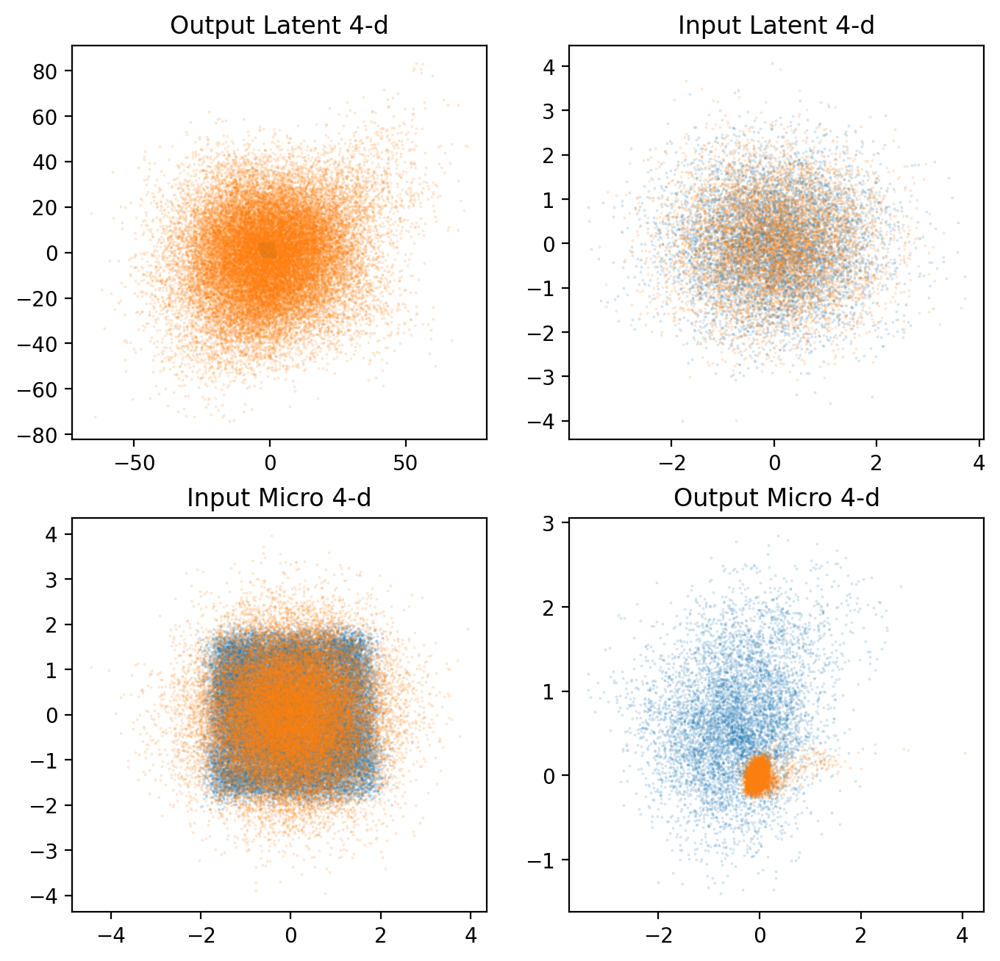

In [63]:
def generate_plot(net_npp,latent_bool=True):
    rcParams['figure.figsize'] = 8, 16
    rcParams['figure.dpi'] = 200
    disp_digits = 6

    y,_,_,z = net_npp.encode(ss)
    #o3 = net_npp.dynamics(o1) + o1
    #o4,o5 = net_npp.decoding1(o3)

    print("—— —— —— Invertible map —— —— ——")
    if latent_bool:
        plt.subplot(4,2,1)
        z = z.cpu().detach().numpy()
        y = y.cpu().detach().numpy()
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(z[:, 2], z[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Output Latent 4-d")

        z = np.random.multivariate_normal(np.zeros(4), np.eye(4), 7000)
        plt.subplot(4,2,2)
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(z[:, 2], z[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Input Latent 4-d")

        plt.subplot(4,2,3)
        x = ss.cpu().detach().numpy()
        plt.scatter(x[:, 0], x[:, 1],s= 0.1,alpha = 0.25)
        plt.scatter(x[:, 2], x[:, 3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Input Micro 4-d")

        plt.subplot(4,2,4)
        z = distributions.MultivariateNormal(torch.zeros(4,device=device), torch.eye(4,device=device)).sample((7000, 1))[:,0]
        x = net_npp.encoder.inverse(z)
        x = x.cpu().detach().numpy()
        plt.scatter(x[:,0], x[:,1],s= 0.1,alpha = 0.25)
        plt.scatter(x[:,2], x[:,3],s= 0.1,alpha = 0.25)
        # plt.ylim(bottom = -4, top = 4)
        # plt.xlim(left = -4, right = 4)
        plt.title("Output Micro 4-d")
    else:
        rcParams['figure.figsize'] = 8, 4
        rcParams['figure.dpi'] = 200
        plt.subplot(1,2,1)
        z1 = o1.cpu().detach().numpy()
        z2 = o2.cpu().detach().numpy()
        plt.scatter(z1[:, 0], z1[:, 1],s= 0.1,alpha = 0.25)
        plt.title("Output Latent 2-d")

        z = np.random.multivariate_normal(np.zeros(4), np.eye(4), 7000)
        plt.subplot(1,2,2)
        plt.scatter(z[:, 0], z[:, 1],s= 0.1,alpha = 0.25)
        plt.title("Input Latent 2-d")
#测试GNIS的隐空间
generate_plot(nisp_net, latent_bool=True)

In [64]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)
count_parameters(gnis_net)

11200

Text(0.5, 1.0, 'micro prediction loss')

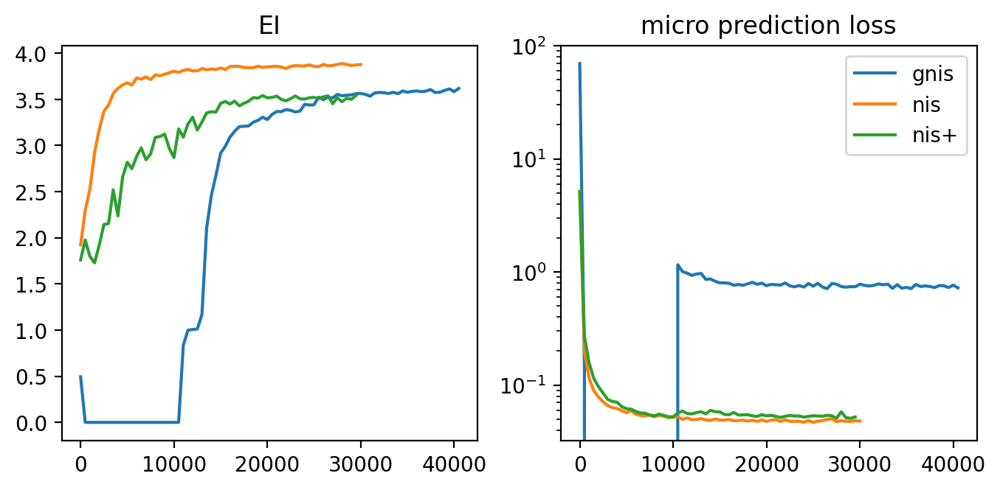

In [65]:
plt.subplot(4,2,1)
# stage_gnis_ei = np.load('results3/gnis_f=50_ei.npy')
gnis_ei = np.load('results2/rw_nice_gnis_ei.npy')
nis_ei = np.load('results2/nis_ei.npy')
nisp_ei = np.load('results2/nisp_ei.npy')

plt.plot(np.arange(len(gnis_ei))*500, gnis_ei)
# plt.plot(np.arange(stage_gnis_ei.shape[1])*50, stage_gnis_ei[0,:])
plt.plot(np.arange(len(nis_ei))*500, nis_ei)
plt.plot(np.arange(len(nisp_ei))*500, nisp_ei)
plt.title('EI')

plt.subplot(4,2,2)
# stage_gnis_ei = np.load('results3/gnis_f=50_micro_mae.npy')
gnis_ei = np.load('results2/rw_nice_gnis_loss.npy')
nis_ei = np.load('results2/nis_loss.npy')
nisp_ei = np.load('results2/nisp_loss.npy')

plt.plot(np.arange(len(gnis_ei))*500, gnis_ei, label='gnis')
# plt.plot(np.arange(stage_gnis_ei.shape[1])*50, stage_gnis_ei[0,:], label='gnis f=50')
plt.plot(np.arange(len(nis_ei.T))*500, nis_ei.T, label='nis')
plt.plot(np.arange(len(nisp_ei))*500, nisp_ei, label='nis+')
plt.yscale('log')
plt.legend()
plt.title('micro prediction loss')

Text(0.5, 1.0, 'NIS+')

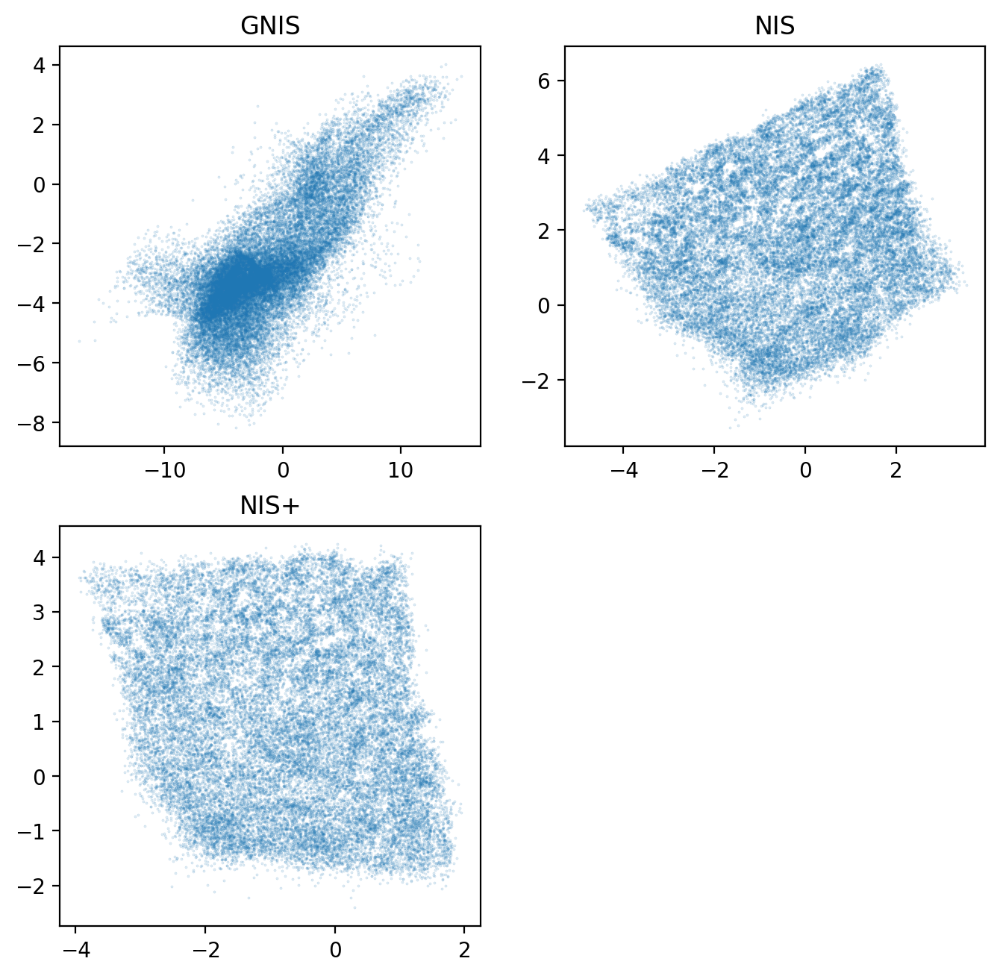

In [66]:
plt.subplot(4,2,1)
y,_,_,z = gnis_net.encode(ss)
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("GNIS")

plt.subplot(4,2,2)
y,_,_,z = nis_net.encode(ss)
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("NIS")

plt.subplot(4,2,3)
y,_,_,z = nisp_net.encode(ss)
y = y.cpu().detach().numpy()
plt.scatter(y[:, 0], y[:, 1],s= 0.1,alpha = 0.25)
plt.title("NIS+")

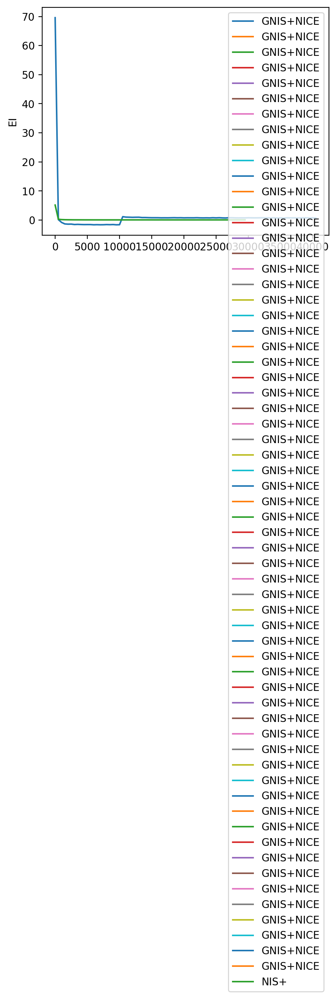

In [67]:
#NIS的EI，可以和NIS的画在一张图里
plt.figure(figsize=(5,4))

# ei_mean=np.mean(gnis_ei_list,axis=0)
# ei_std=np.std(gnis_ei_list,axis=0)
# timesteps = np.arange(len(ei_mean)) * 500
# plt.plot(timesteps, ei_mean, label='GNIS+NICE')
# plt.fill_between(timesteps, ei_mean-ei_std, ei_mean+ei_std,alpha=0.25)

timesteps = np.arange(len(gnis_ei)) * 500
plt.plot(timesteps, gnis_ei, label='GNIS+NICE')

# ei_mean=np.mean(nis_ei_list,axis=0)
# ei_std=np.std(nis_ei_list,axis=0)
# timesteps = np.arange(len(ei_mean)) * 500
# plt.plot(timesteps, ei_mean, label='NIS NICE')
# plt.fill_between(timesteps, ei_mean-ei_std, ei_mean+ei_std,alpha=0.25)

timesteps = np.arange(len(nis_ei)) * 500
plt.plot(timesteps, nis_ei, label='GNIS+NICE')

# ei_mean=np.mean(nisp_ei,axis=0)
# ei_std=np.std(nisp_ei,axis=0)
# timesteps = np.arange(len(ei_mean)) * 500
# plt.plot(timesteps, ei_mean, label='NIS NICE')
# plt.fill_between(timesteps, ei_mean-ei_std, ei_mean+ei_std, alpha=0.25)

timesteps = np.arange(len(nisp_ei)) * 500
plt.plot(timesteps, nisp_ei, label='NIS+')

plt.ylabel('EI')
plt.legend()

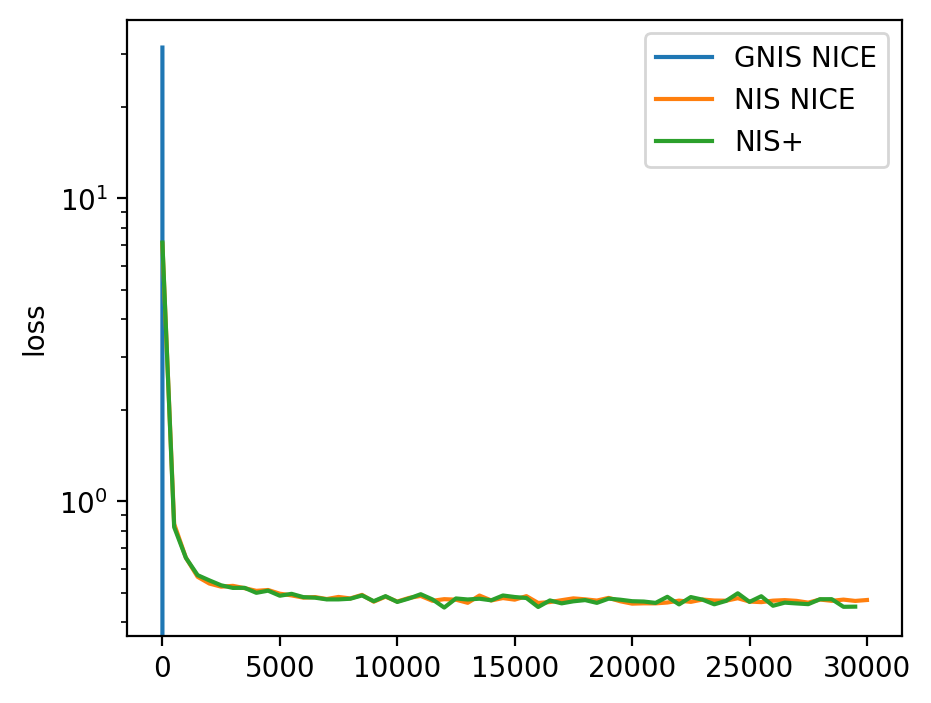

In [68]:
#NIS的loss，可以和NIS的画在一张图里
plt.figure(figsize=(5,4))

# loss_mean = np.mean(nonstacked_gnis_loss_list,axis=0)
# loss_std = np.std(nonstacked_gnis_loss_list,axis=0)
# timesteps = np.arange(len(loss_mean)) * 500
# plt.plot(timesteps, loss_mean, label='GNIS NICE')
# plt.fill_between(timesteps, loss_mean-loss_std, loss_mean+loss_std,alpha=0.25)

gnis_loss = gnis_loss_list
nis_loss = nis_loss_list

loss_mean = np.mean(gnis_loss,axis=0)
loss_std = np.std(gnis_loss,axis=0)
timesteps = np.arange(len(loss_mean)) * 500
plt.yscale('log')
plt.plot(timesteps, loss_mean, label='GNIS NICE')
plt.fill_between(timesteps, loss_mean-loss_std, loss_mean+loss_std,alpha=0.25)

loss_mean = np.mean(nis_loss,axis=0)
loss_std = np.std(nis_loss,axis=0)
timesteps = np.arange(len(loss_mean)) * 500
plt.yscale('log')
plt.plot(timesteps, loss_mean, label='NIS NICE')
plt.fill_between(timesteps, loss_mean-loss_std, loss_mean+loss_std,alpha=0.25)

timesteps = np.arange(len(nisp_loss)) * 500
plt.yscale('log')
plt.plot(timesteps, nisp_loss, label='NIS+')

plt.ylabel('loss')
plt.legend()

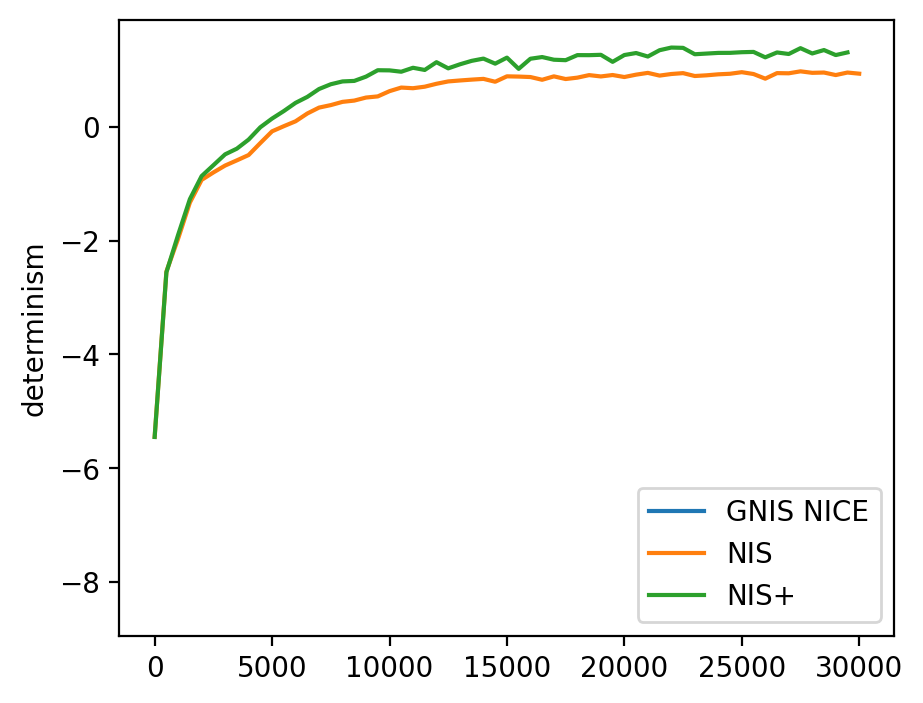

In [69]:
#GNIS的determine，可以和NIS的画在一张图里
plt.figure(figsize=(5,4))
# ei_mean=np.mean(gnis_term2,axis=0)
# ei_std=np.std(gnis_term2,axis=0)
# timesteps = np.arange(len(ei_mean)) * 500
#plt.plot(timesteps, ei_mean, label='NIS Realnvp length=6')
#plt.fill_between(timesteps, ei_mean-ei_std, ei_mean+ei_std,alpha=0.25)
#plt.plot(timesteps, term1_nn, label='term1')
# plt.plot(timesteps, nonstacked_gnis_term1, label='GNIS')
timesteps = np.arange(len(gnis_term1)) * 500
plt.plot(timesteps, gnis_term1, label='GNIS NICE')
timesteps = np.arange(len(nis_term1)) * 500
plt.plot(timesteps, nis_term1, label='NIS')
timesteps = np.arange(len(nisp_term1)) * 500
plt.plot(timesteps, nisp_term1, label='NIS+')
plt.ylabel('determinism')
plt.legend()

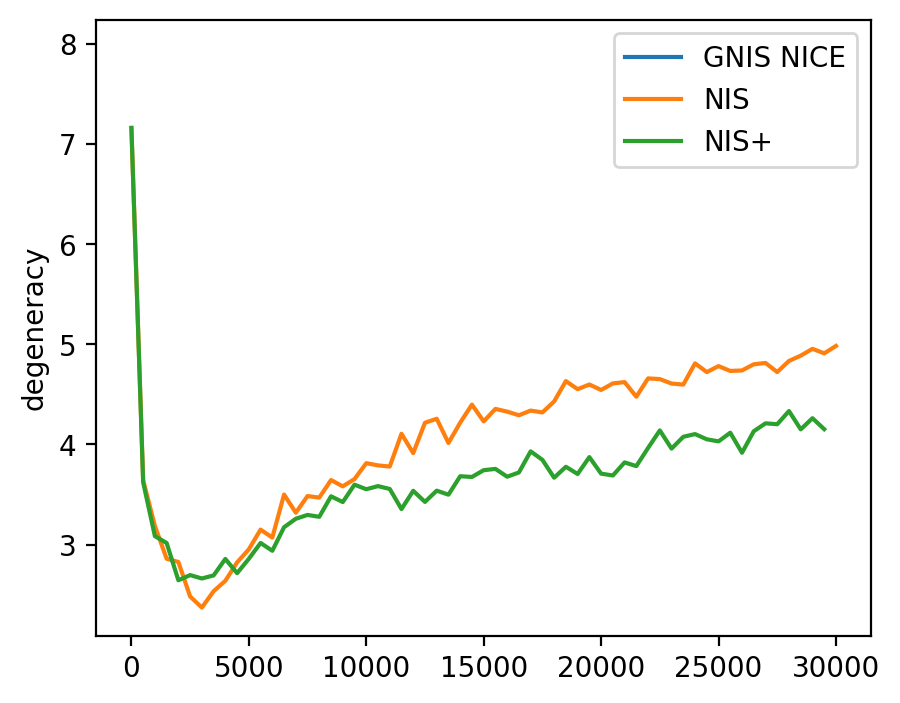

In [70]:
#GNIS的degeneracy，可以和NIS的画在一张图里
plt.figure(figsize=(5,4))
# ei_mean=np.mean(gnis_term2,axis=0)
# ei_std=np.std(gnis_term2,axis=0)
# timesteps = np.arange(len(ei_mean)) * 500
#plt.plot(timesteps, ei_mean, label='NIS Realnvp length=6')
#plt.fill_between(timesteps, ei_mean-ei_std, ei_mean+ei_std,alpha=0.25)
#plt.plot(timesteps, term1_nn, label='term1')
# plt.plot(timesteps, nonstacked_gnis_term2, label='GNIS')
timesteps = np.arange(len(gnis_term2)) * 500
plt.plot(timesteps, gnis_term2, label='GNIS NICE')
timesteps = np.arange(len(nis_term2)) * 500
plt.plot(timesteps, nis_term2, label='NIS')
timesteps = np.arange(len(nisp_term2)) * 500
plt.plot(timesteps, nisp_term2, label='NIS+')
plt.ylabel('degeneracy')
plt.legend()

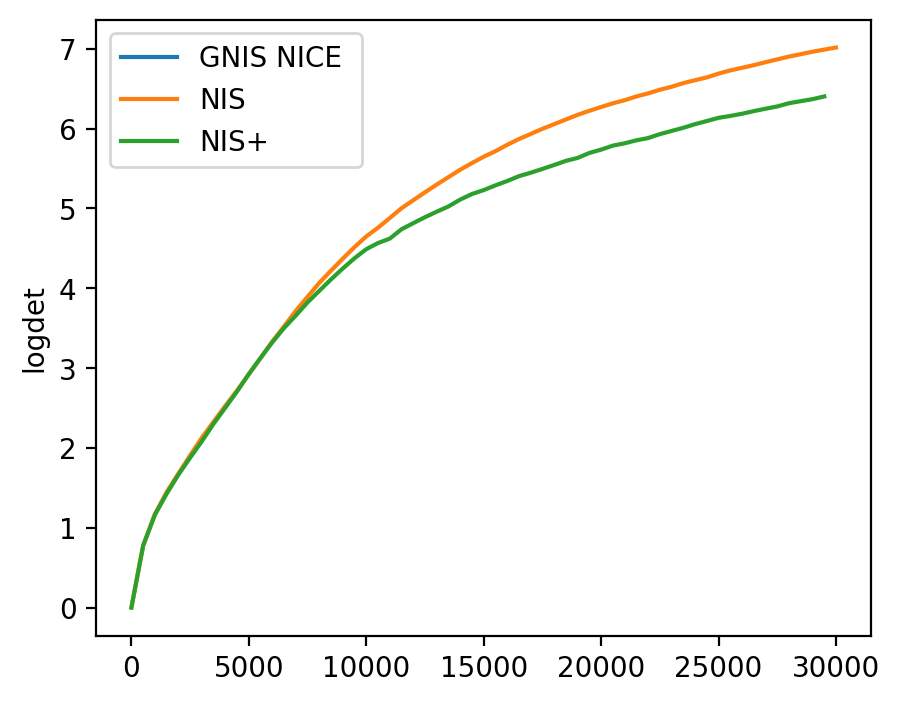

In [71]:
plt.figure(figsize=(5,4))
timesteps = np.arange(len(gnis_logdet)) * 500
plt.plot(timesteps, gnis_logdet, label='GNIS NICE ')
timesteps = np.arange(len(nis_logdet)) * 500
plt.plot(timesteps, nis_logdet, label='NIS')
timesteps = np.arange(len(nisp_logdet)) * 500
plt.plot(timesteps, nisp_logdet, label='NIS+')
plt.ylabel('logdet')
plt.legend()

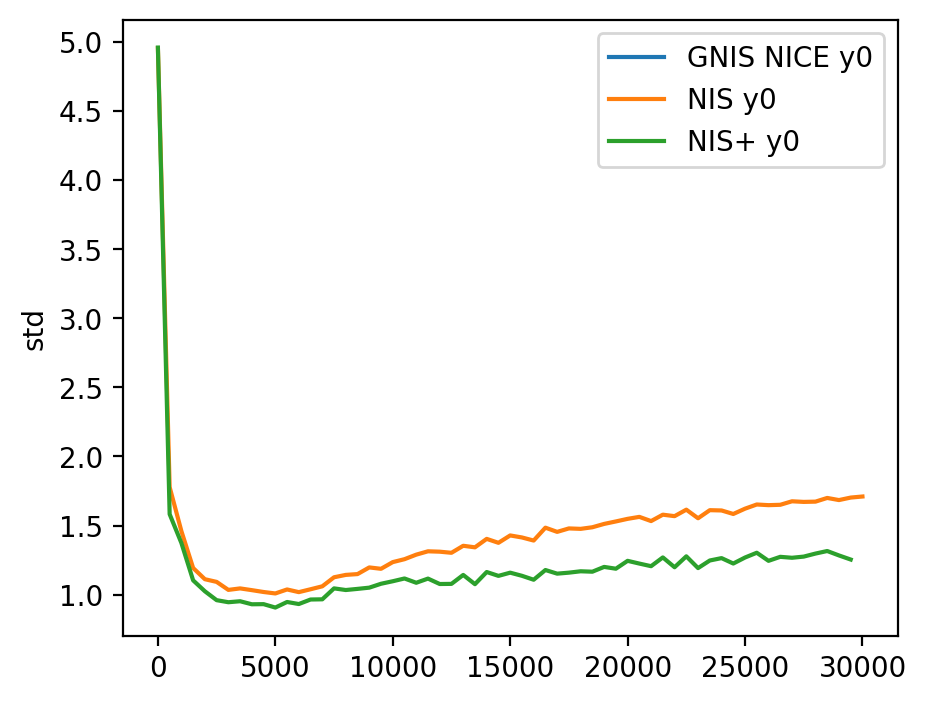

In [72]:
plt.figure(figsize=(5,4))
timesteps = np.arange(len(gnis_y0_std)) * 500
plt.plot(timesteps, gnis_y0_std, label='GNIS NICE y0')
# plt.plot(timesteps, gnis_y1_std, label='GNIS NICE y1')
timesteps = np.arange(len(nis_y0_std)) * 500
plt.plot(timesteps, nis_y0_std, label='NIS y0')
# plt.plot(timesteps, nis_y1_std, label='NIS y1')
timesteps = np.arange(len(nisp_y0_std)) * 500
plt.plot(timesteps, nisp_y0_std, label='NIS+ y0')
# plt.plot(timesteps, nisp_y1_std, label='NIS+ y1')
plt.ylabel('std')
plt.legend()

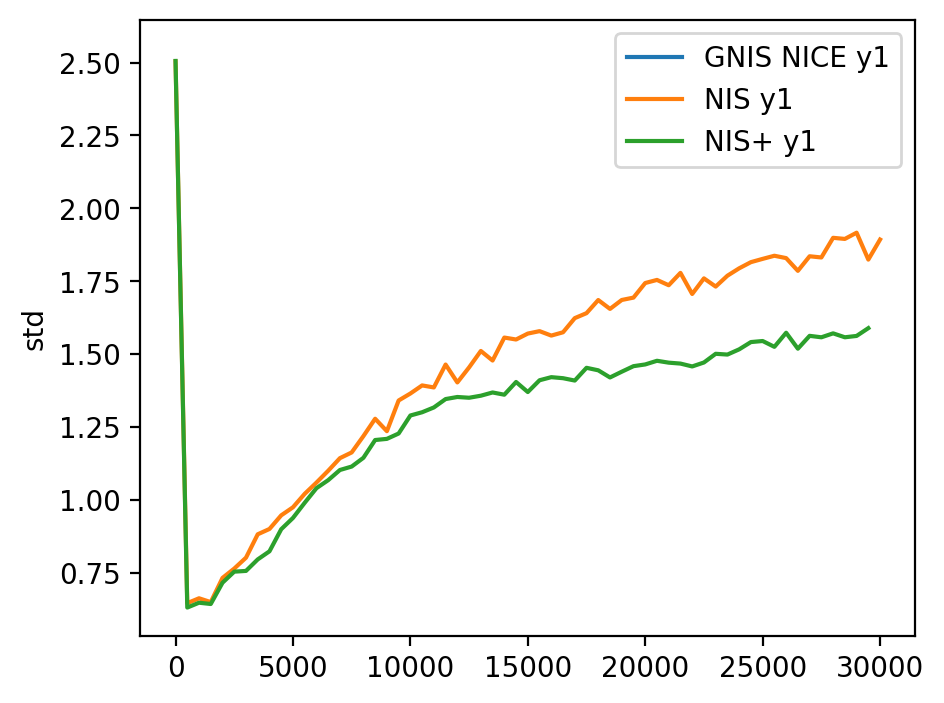

In [73]:
plt.figure(figsize=(5,4))
timesteps = np.arange(len(gnis_y0_std)) * 500
# plt.plot(timesteps, gnis_y0_std, label='GNIS NICE y0')
plt.plot(timesteps, gnis_y1_std, label='GNIS NICE y1')
timesteps = np.arange(len(nis_y0_std)) * 500
# plt.plot(timesteps, nis_y0_std, label='NIS y0')
plt.plot(timesteps, nis_y1_std, label='NIS y1')
timesteps = np.arange(len(nisp_y0_std)) * 500
# plt.plot(timesteps, nisp_y0_std, label='NIS+ y0')
plt.plot(timesteps, nisp_y1_std, label='NIS+ y1')
plt.ylabel('std')
plt.legend()


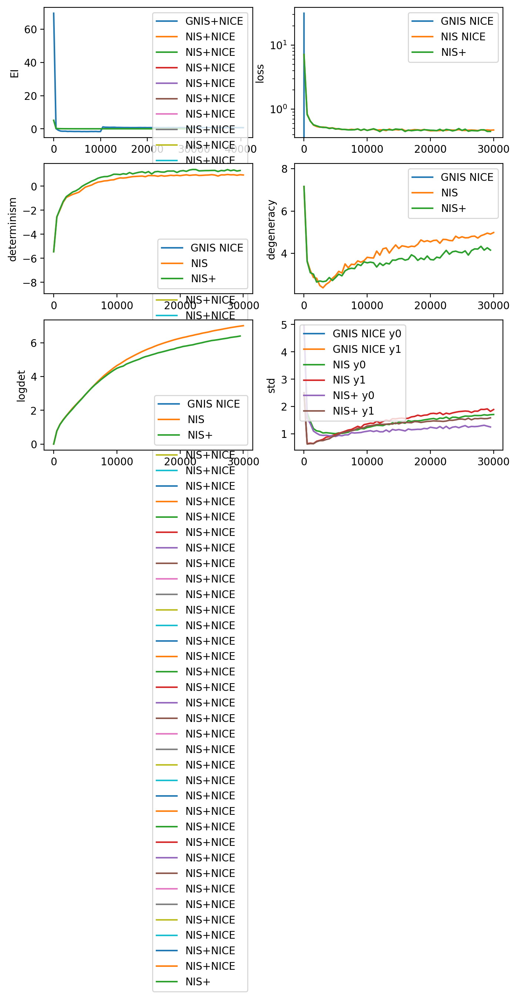

In [74]:
plt.subplot(6,2,1)
timesteps = np.arange(len(gnis_ei)) * 500
plt.plot(timesteps, gnis_ei, label='GNIS+NICE')

timesteps = np.arange(len(nis_ei)) * 500
plt.plot(timesteps, nis_ei, label='NIS+NICE')


timesteps = np.arange(len(nisp_ei)) * 500
plt.plot(timesteps, nisp_ei, label='NIS+')

plt.ylabel('EI')
plt.legend()


# ======

plt.subplot(6,2,2)
gnis_loss = gnis_loss_list
nis_loss = nis_loss_list

loss_mean = np.mean(gnis_loss,axis=0)
loss_std = np.std(gnis_loss,axis=0)
timesteps = np.arange(len(loss_mean)) * 500
plt.yscale('log')
plt.plot(timesteps, loss_mean, label='GNIS NICE')
plt.fill_between(timesteps, loss_mean-loss_std, loss_mean+loss_std,alpha=0.25)

loss_mean = np.mean(nis_loss,axis=0)
loss_std = np.std(nis_loss,axis=0)
timesteps = np.arange(len(loss_mean)) * 500
plt.yscale('log')
plt.plot(timesteps, loss_mean, label='NIS NICE')
plt.fill_between(timesteps, loss_mean-loss_std, loss_mean+loss_std,alpha=0.25)

timesteps = np.arange(len(nisp_loss)) * 500
plt.yscale('log')
plt.plot(timesteps, nisp_loss, label='NIS+')

plt.ylabel('loss')
plt.legend()

# ======


plt.subplot(6,2,3)
timesteps = np.arange(len(gnis_term1)) * 500
plt.plot(timesteps, gnis_term1, label='GNIS NICE')
timesteps = np.arange(len(nis_term1)) * 500
plt.plot(timesteps, nis_term1, label='NIS')
timesteps = np.arange(len(nisp_term1)) * 500
plt.plot(timesteps, nisp_term1, label='NIS+')
plt.ylabel('determinism')
plt.legend()

# ======

plt.subplot(6,2,4)
timesteps = np.arange(len(gnis_term2)) * 500
plt.plot(timesteps, gnis_term2, label='GNIS NICE')
timesteps = np.arange(len(nis_term2)) * 500
plt.plot(timesteps, nis_term2, label='NIS')
timesteps = np.arange(len(nisp_term2)) * 500
plt.plot(timesteps, nisp_term2, label='NIS+')
plt.ylabel('degeneracy')
plt.legend()


# ======

plt.subplot(6,2,5)
timesteps = np.arange(len(gnis_logdet)) * 500
plt.plot(timesteps, gnis_logdet, label='GNIS NICE ')
timesteps = np.arange(len(nis_logdet)) * 500
plt.plot(timesteps, nis_logdet, label='NIS')
timesteps = np.arange(len(nisp_logdet)) * 500
plt.plot(timesteps, nisp_logdet, label='NIS+')
plt.ylabel('logdet')
plt.legend()




# ======

plt.subplot(6,2,6)
timesteps = np.arange(len(gnis_y0_std)) * 500
plt.plot(timesteps, gnis_y0_std, label='GNIS NICE y0')
plt.plot(timesteps, gnis_y1_std, label='GNIS NICE y1')
timesteps = np.arange(len(nis_y0_std)) * 500
plt.plot(timesteps, nis_y0_std, label='NIS y0')
plt.plot(timesteps, nis_y1_std, label='NIS y1')
timesteps = np.arange(len(nisp_y0_std)) * 500
plt.plot(timesteps, nisp_y0_std, label='NIS+ y0')
plt.plot(timesteps, nisp_y1_std, label='NIS+ y1')
plt.ylabel('std')
plt.legend()

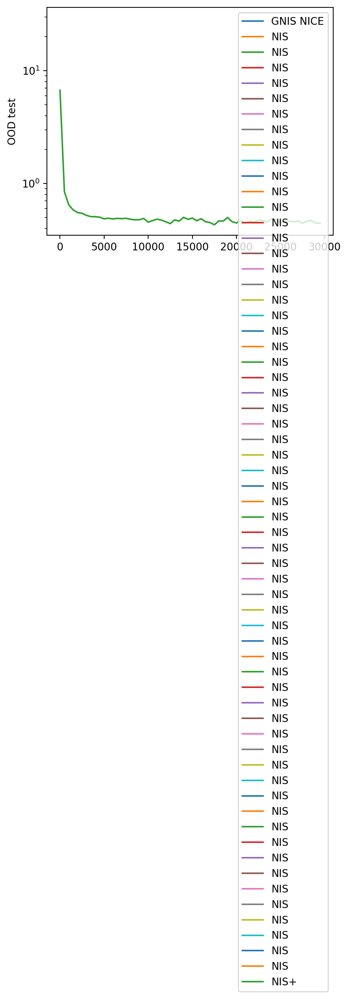

In [75]:
plt.figure(figsize=(5,4))
# ei_mean=np.mean(gnis_term2,axis=0)
# ei_std=np.std(gnis_term2,axis=0)
# timesteps = np.arange(len(ei_mean)) * 500
#plt.plot(timesteps, ei_mean, label='NIS Realnvp length=6')
#plt.fill_between(timesteps, ei_mean-ei_std, ei_mean+ei_std,alpha=0.25)
#plt.plot(timesteps, term1_nn, label='term1')
# plt.plot(timesteps, nonstacked_gnis_term1, label='GNIS')
timesteps = np.arange(len(gnis_ood_test)) * 500
plt.plot(timesteps, gnis_ood_test, label='GNIS NICE')
plt.plot(timesteps, nis_ood_test, label='NIS')
timesteps = np.arange(len(nisp_ood_test)) * 500
plt.plot(timesteps, nisp_ood_test, label='NIS+')
plt.yscale('log')
plt.ylabel('OOD test')
plt.legend()

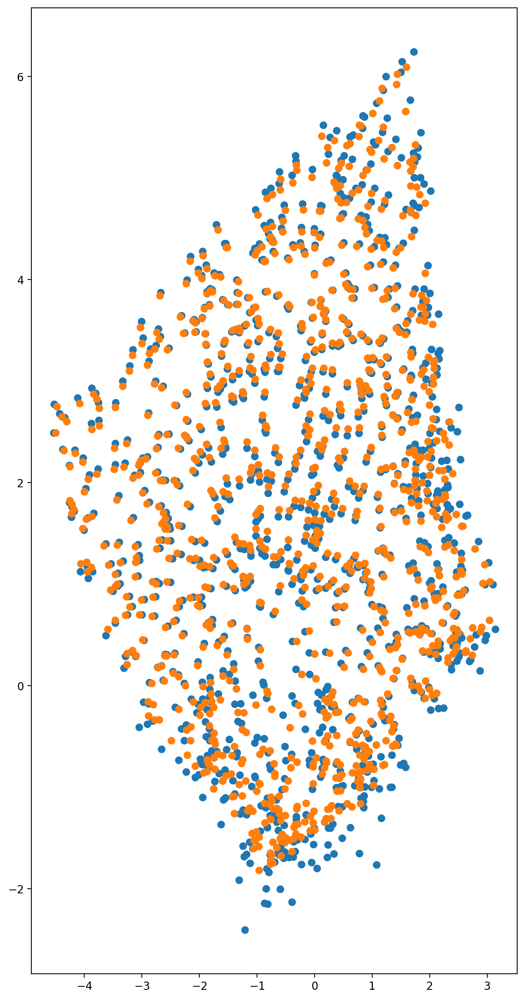

In [76]:
plt.scatter(latent[:,0].cpu().detach().numpy(),latent[:,1].cpu().detach().numpy())
plt.scatter(latentp[:,0].cpu().detach().numpy(),latentp[:,1].cpu().detach().numpy())